<a href="https://colab.research.google.com/github/samuhin/TimeSeries/blob/main/TimeSeries.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Установка и импортирование библиотек

##Устанавливаем нестандартные библиотеки

###Библиотека для работы с котировками

In [1]:
!pip install yfinance

###Библиотека для работы с метриками

In [2]:
!pip install ml_metrics

##Импортируем основные библиотеки

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import yfinance
from matplotlib import pyplot
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from keras.models import Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout
from keras.layers import LSTM
from keras.layers import GRU
from keras.layers import SimpleRNN
from sklearn.linear_model import LinearRegression

##Конфигурация для получения изображений высокой чёткости

In [4]:
%config InlineBackend.figure_format = 'retina'

#Загрузка данных и предобработка данных

##Загрузка

Выбираем временной промежуток

In [5]:
start_date = '2017-01-01'
end_date = '2020-12-31'

Загружаем данные

In [6]:
 data = yfinance.download("AUDUSD=X CADUSD=X CHFUSD=X \
                          CNYUSD=X DKKUSD=X EURUSD=X \
                          GBPUSD=X HKDUSD=X JPYUSD=X \
                          KZTUSD=X NOKUSD=X NZDUSD=X \
                          PLNUSD=X RUBUSD=X SEKUSD=X",
                        start=start_date, end=end_date)

[*********************100%***********************]  15 of 15 completed


Посмотрим на скачанные данные (закрытие)

In [7]:
 data['Close'].head()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
Date,,,,,,,,,,,,,,,
2017-01-02,0.720981,0.744380,0.981653,0.144013,0.141589,1.052698,1.234903,0.128949,0.008562,0.003012,0.115845,0.693433,0.239261,0.016332,0.110110
2017-01-03,0.719683,0.743970,0.976381,0.144009,0.140689,1.046003,1.228199,0.128901,0.008511,0.003022,0.115547,0.693193,0.237208,0.016332,0.109632
2017-01-04,0.722993,0.745057,0.974564,0.143682,0.140155,1.041992,1.224560,0.128927,0.008499,0.003028,0.115737,0.692377,0.237595,0.016414,0.109269
2017-01-05,0.728704,0.751936,0.980277,0.144402,0.141231,1.050089,1.232681,0.128950,0.008539,0.003036,0.116524,0.696330,0.240393,0.016566,0.109964
2017-01-06,0.733837,0.755892,0.990305,0.145182,0.142680,1.060592,1.242545,0.128959,0.008676,0.003062,0.117927,0.702149,0.243142,0.016835,0.111151


Посмотрим описание данных

In [8]:
 data['Close'].describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1020.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147448,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145966,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150578,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


##Предобработка

Заполним пропуски в данных

In [9]:
 new_data = data['Close'].interpolate(method='polynomial', order=3)

Посмотрим на результаты заполнения

In [10]:
 new_data.describe()

,AUDUSD=X,CADUSD=X,CHFUSD=X,CNYUSD=X,DKKUSD=X,EURUSD=X,GBPUSD=X,HKDUSD=X,JPYUSD=X,KZTUSD=X,NOKUSD=X,NZDUSD=X,PLNUSD=X,RUBUSD=X,SEKUSD=X
count,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000,1021.000000
mean,0.725972,0.760871,1.028447,0.147444,0.153501,1.144000,1.297346,0.128135,0.009128,0.002769,0.116271,0.679164,0.265455,0.015635,0.112031
std,0.042692,0.022069,0.033005,0.004888,0.006193,0.045590,0.046177,0.000614,0.000233,0.000281,0.007867,0.034528,0.013252,0.001421,0.006710
min,0.574290,0.689741,0.974564,0.139315,0.140155,1.041992,1.149439,0.127369,0.008499,0.002201,0.085035,0.562610,0.233536,0.012358,0.095797
25%,0.697204,0.749176,1.005429,0.144161,0.149027,1.112929,1.268875,0.127514,0.008950,0.002592,0.111079,0.657138,0.258160,0.014896,0.106778
50%,0.723589,0.759359,1.019056,0.145964,0.152488,1.137540,1.296512,0.128008,0.009113,0.002679,0.116989,0.678509,0.264643,0.015673,0.111624
75%,0.758743,0.772917,1.040139,0.150577,0.158213,1.177745,1.320795,0.128810,0.009298,0.003037,0.122119,0.704072,0.272327,0.016909,0.115864
max,0.811688,0.825948,1.134327,0.159551,0.168059,1.251001,1.434206,0.129039,0.009698,0.003263,0.130875,0.752570,0.301181,0.017976,0.127521


#Подготовка к анализу данных как временного ряда

Напишем функция для преобразование данных в удобную форму для работы с ними

In [11]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

Введём дополнительные регрессоры (если нужно)

In [12]:
#new_data['day'] = new_data.index.day
#new_data['month'] = new_data.index.month

Переведём данные в numpy-массив:

In [13]:
values = new_data.values
values

array([[0.72098053, 0.74437994, 0.98165292, ..., 0.23926078, 0.01633152,
        0.11011021],
       [0.71968335, 0.7439701 , 0.97638136, ..., 0.23720796, 0.01633232,
        0.1096323 ],
       [0.7229926 , 0.74505657, 0.97456384, ..., 0.2375946 , 0.01641416,
        0.10926872],
       ...,
       [0.7588923 , 0.77881616, 1.12574577, ..., 0.27210575, 0.01352622,
        0.1210579 ],
       [0.76098984, 0.77990347, 1.13109374, ..., 0.26990852, 0.01350961,
        0.12188224],
       [0.76892906, 0.7842707 , 1.13432705, ..., 0.2686179 , 0.01341886,
        0.12211846]])

Посмотрим какая у него размерность

In [14]:
values.shape 

(1021, 15)

Сделаем преобразование MinMaxScale для данных

In [15]:
# ensure all data is float
values = values.astype('float32')
# normalize features
scaler = MinMaxScaler(feature_range=(0, 1))
scaled = scaler.fit_transform(values)

Посмотрим что получилось:

In [16]:
 scaled

array([[0.6179085 , 0.4011469 , 0.04437256, ..., 0.08463311, 0.7072511 ,
        0.45117784],
       [0.6124444 , 0.39813805, 0.01137638, ..., 0.05428648, 0.70739365,
        0.4361136 ],
       [0.626384  , 0.40611458, 0.        , ..., 0.06000233, 0.7219608 ,
        0.4246533 ],
       ...,
       [0.77760553, 0.6539693 , 0.94628763, ..., 0.57017875, 0.20794702,
        0.796262  ],
       [0.7864411 , 0.661952  , 0.9797621 , ..., 0.5376971 , 0.20499039,
        0.8222463 ],
       [0.8198838 , 0.6940155 , 1.        , ..., 0.5186181 , 0.18883777,
        0.8296921 ]], dtype=float32)

#Разделение выборки на обучающую, тестовую и валидационную

Посмотрим сколько у нас всего единиц времени

In [17]:
len(values)

1021

Настроим параметры и поделим

In [18]:
def split(n_previous, n_predict, train_per, val_per):
  # specify the number of lag hours
  n_hours = n_previous
  n_features = scaled.shape[1]
  n_predict = n_predict

  # frame as supervised learning
  reframed = series_to_supervised(scaled, n_hours, n_predict)

  # split into train and test sets
  values = reframed.values

  n_train_hours = int(len(values) * train_per)
  n_val_hours = int(len(values) * val_per)

  train = values[:n_train_hours, :]
  test = values[n_train_hours:-n_val_hours, :]
  valid = values[-n_val_hours:, :]

  # split into input and outputs
  n_obs = n_hours * n_features
  train_X, train_y = train[:, :n_obs], train[:, n_obs:]
  test_X, test_y = test[:, :n_obs], test[:, n_obs:]
  valid_X, valid_y = valid[:, :n_obs], valid[:, n_obs:]

  # reshape input to be 3D [samples, timesteps, features]
  train_X = train_X.reshape((train_X.shape[0], n_hours, n_features))
  test_X = test_X.reshape((test_X.shape[0], n_hours, n_features))
  valid_X = valid_X.reshape((valid_X.shape[0], n_hours, n_features))
  return (train_X, test_X, valid_X, train_y, test_y, valid_y)

In [19]:
train_X, test_X, valid_X, train_y, test_y, valid_y = split(3, 1, 0.6, 0.15)

#Анализ

##Метрики

Импортируем библиотеку

In [20]:
import ml_metrics as metrics

###MSE

In [21]:
def MSE(y_hat, y_pred):
  pass
  return metrics.mse(y_hat, y_pred)

###RMSE

In [22]:
def RMSE(y_hat, y_pred):
  pass
  return metrics.rmse(y_hat, y_pred)

###MAE

In [23]:
def MAE(y_hat, y_pred):
  pass
  return metrics.mae(y_hat, y_pred)

##Создаём таблицу результатов

In [24]:
table = pd.DataFrame(columns=['MSE', 'RMSE', 'MAE'])
table

,MSE,RMSE,MAE


##Наивный алгоритм

####Вычисления

Составляем предсказание

In [25]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:][-1]])))
    y_pred.append(temp_pred[-1])
  i = i + n

Выполяем обратное преобразование

In [26]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график предсказания

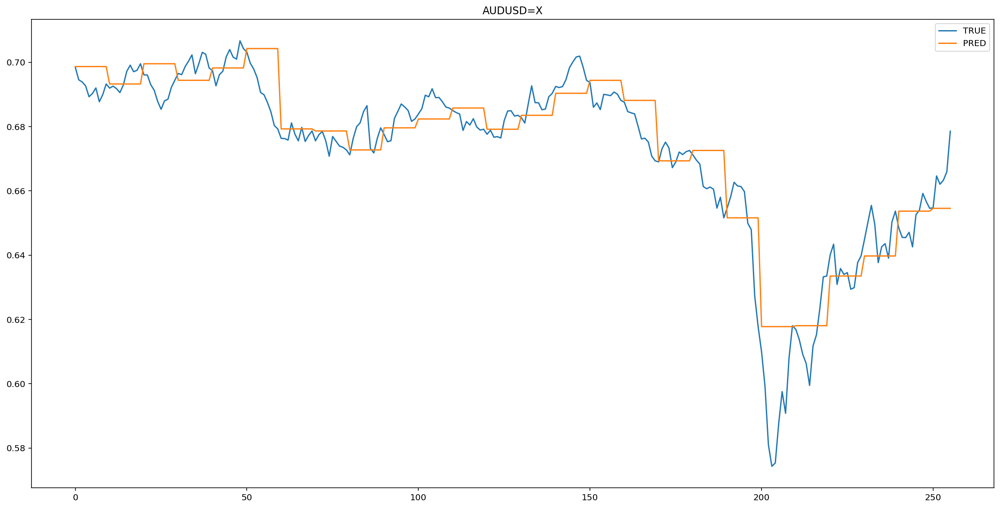

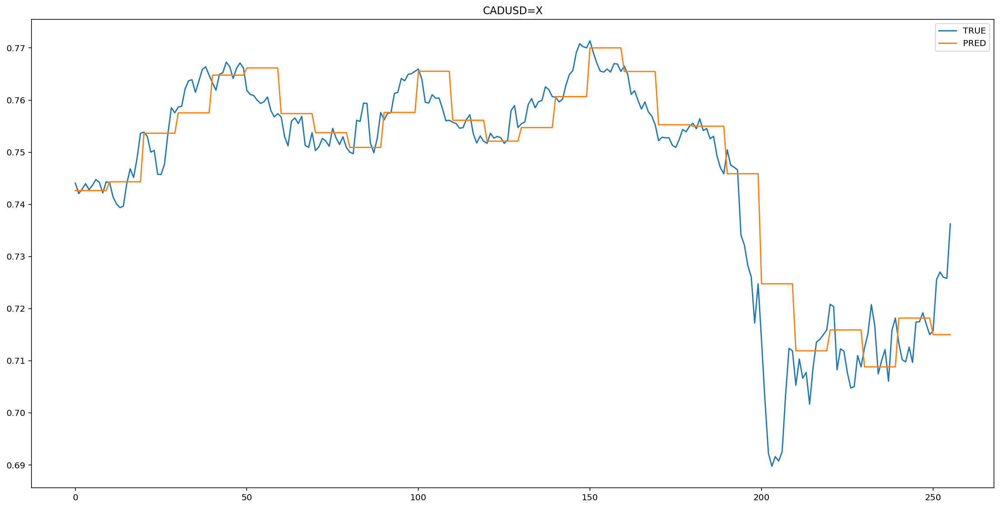

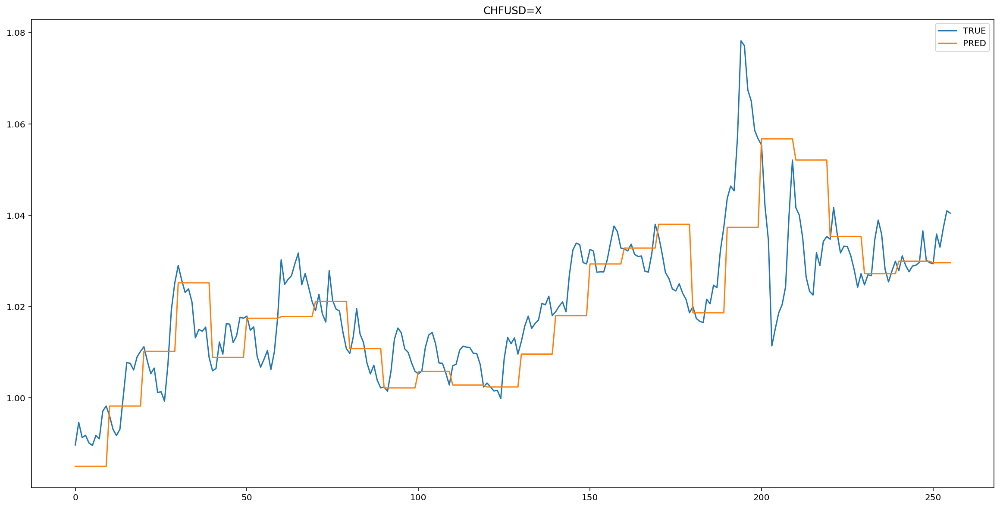

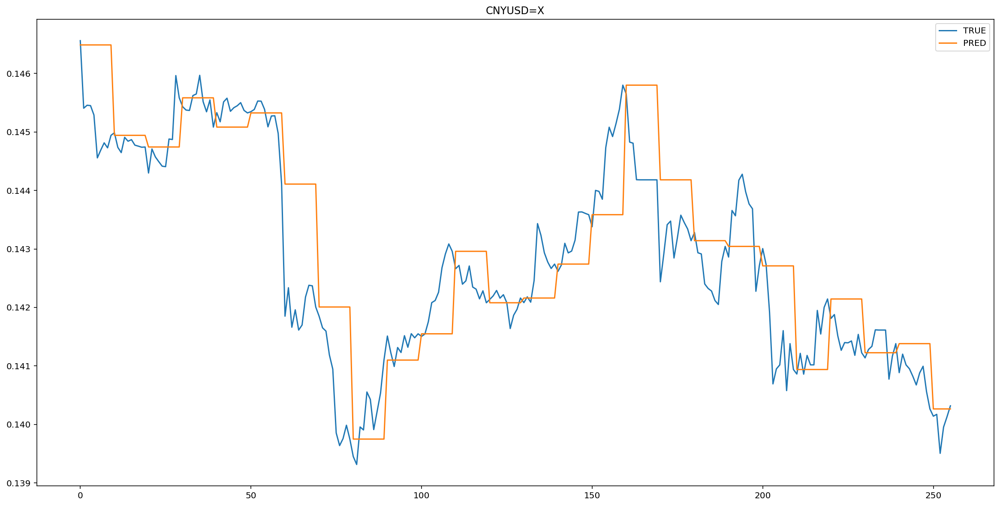

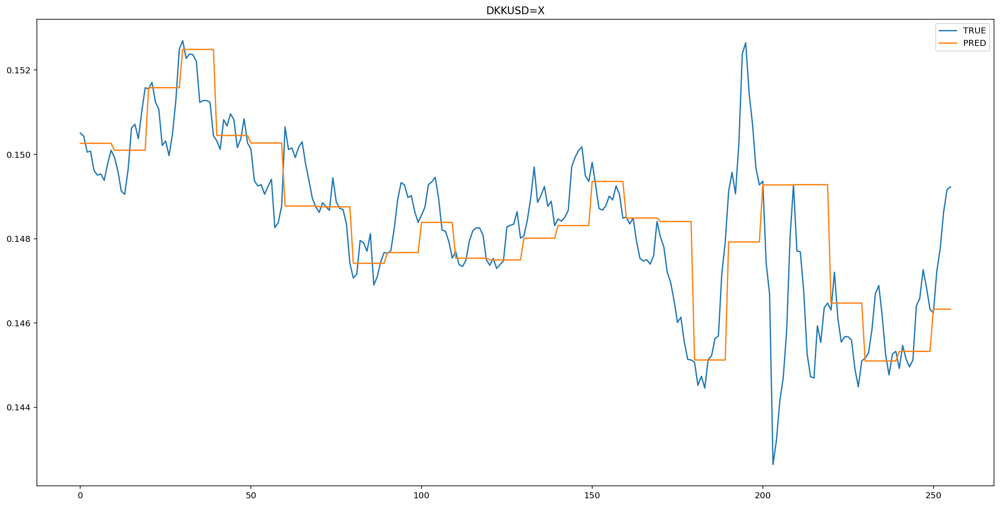

...

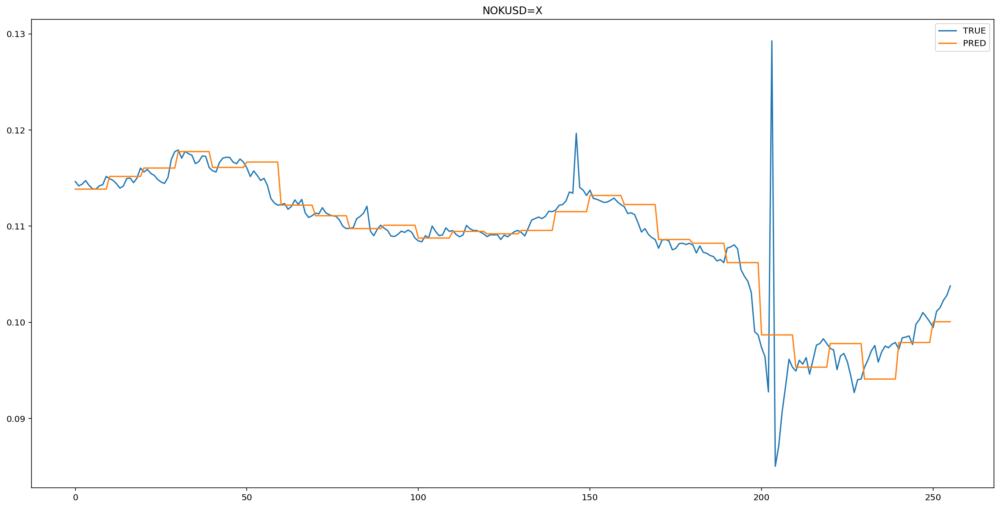

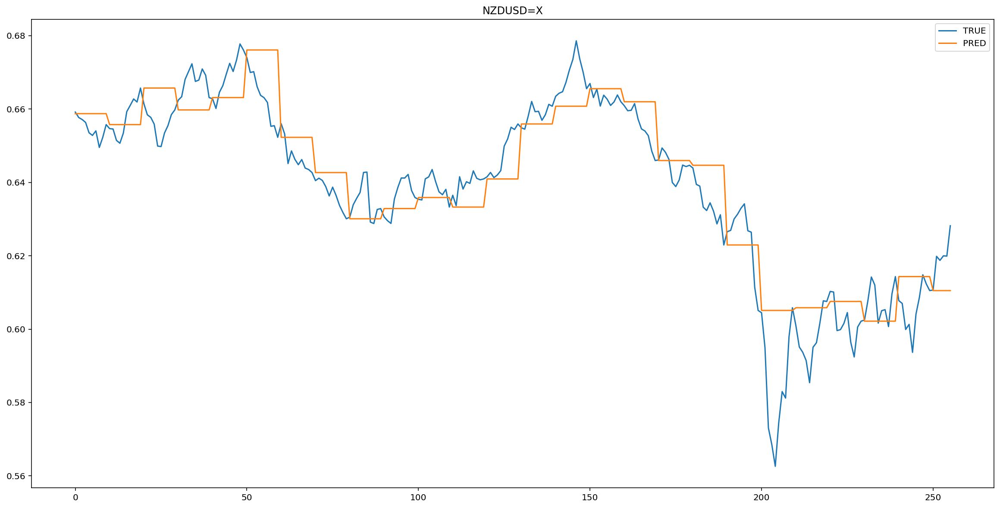

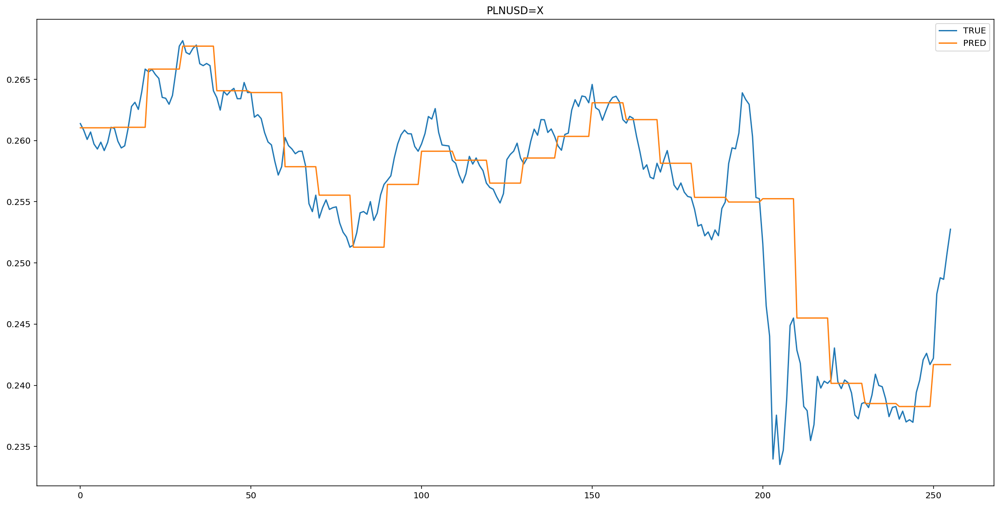

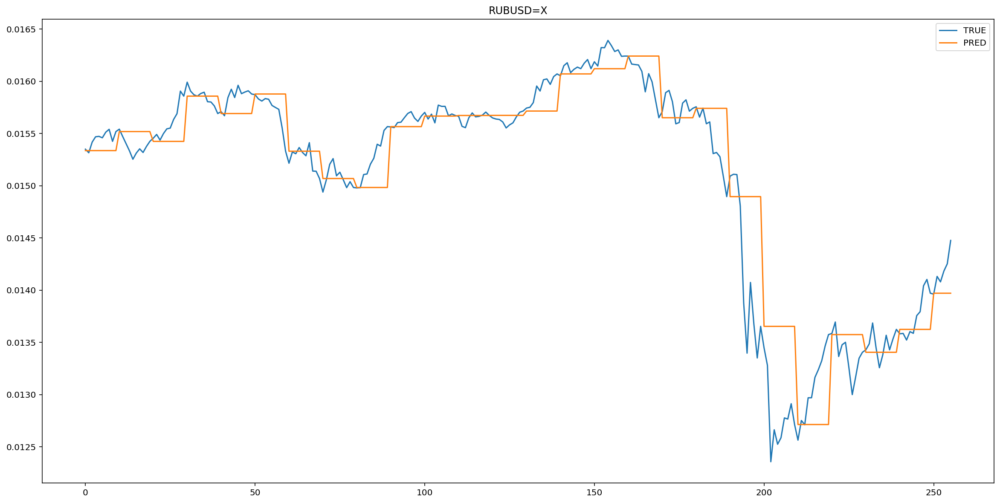

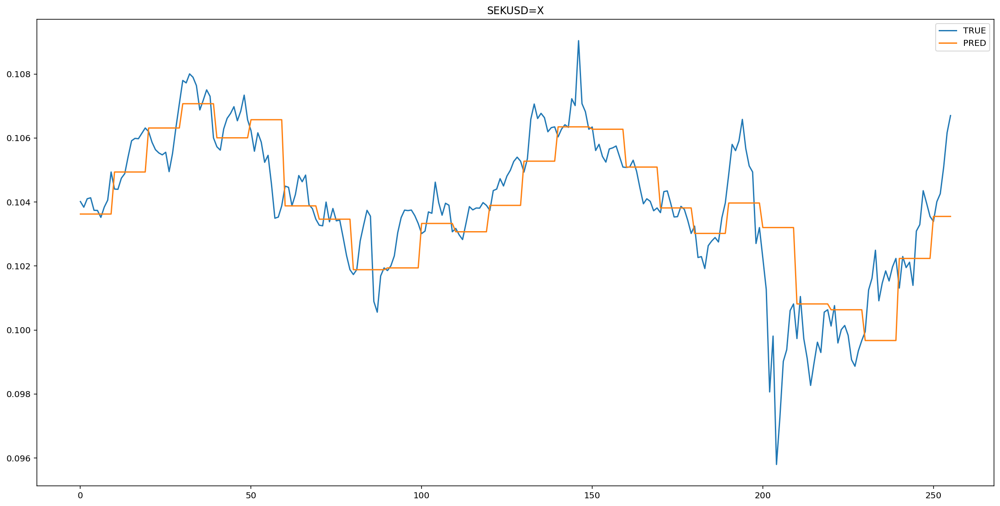

In [27]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

###Оцениваем точность

In [28]:
table.loc['naive'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [29]:
MSE(y_hat, y_pred)

5.8025744e-05

In [30]:
RMSE(y_hat, y_pred)

0.007617463

In [31]:
MAE(y_hat, y_pred)

0.0036440634

##Среднее

###Простое среднее

####Вычисления

Составляем предсказание

In [32]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.array([temp_pred[-n:].mean(axis = 0)]) #простое среднее
    y_pred.append(temp_pred[-1])
  i = i + n

Делаем обратное предсказание

In [33]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим графики

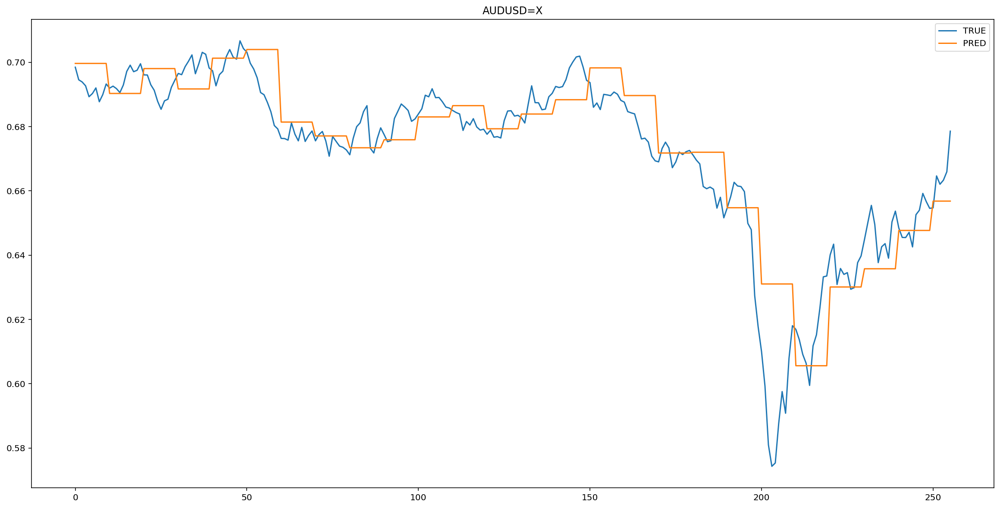

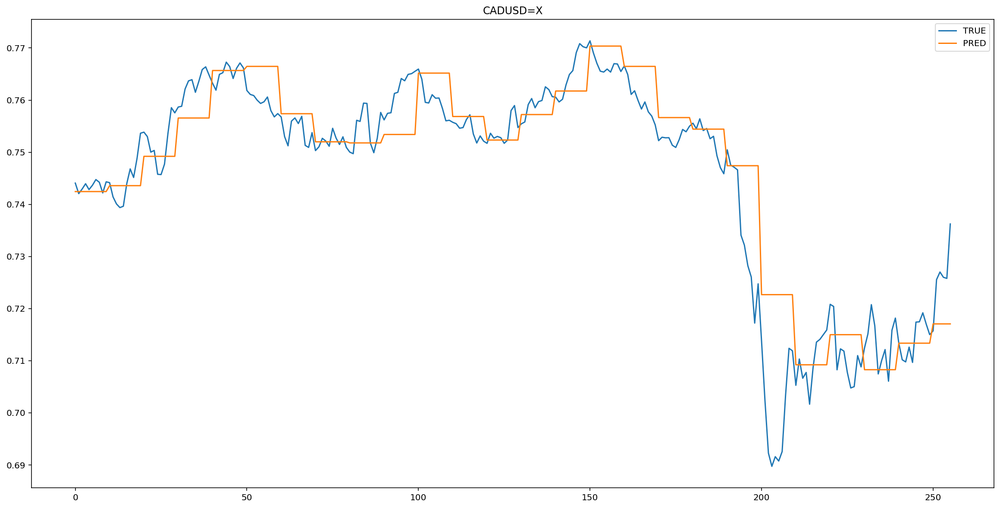

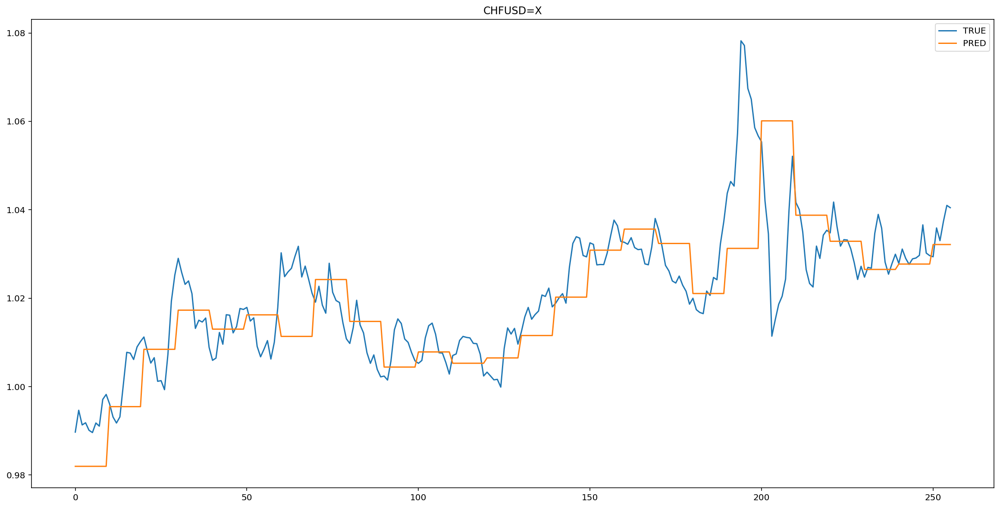

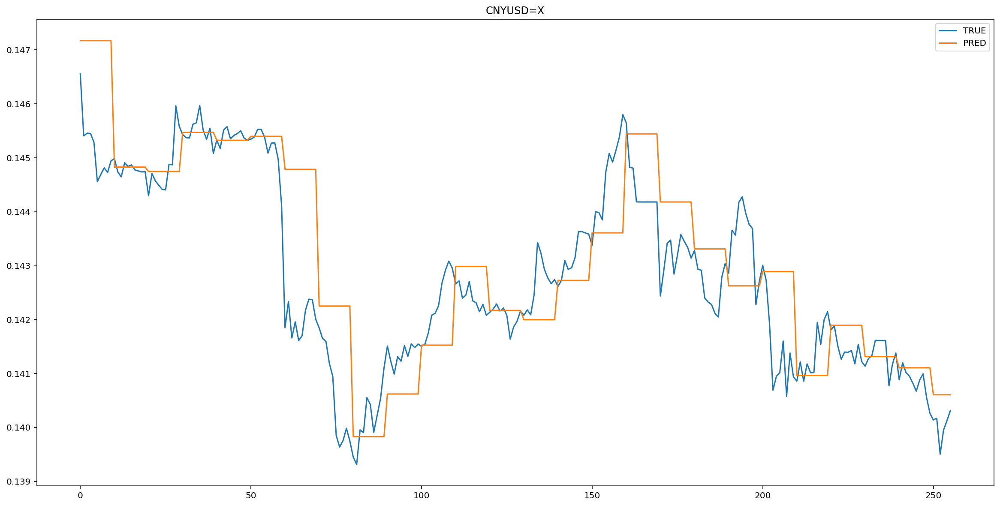

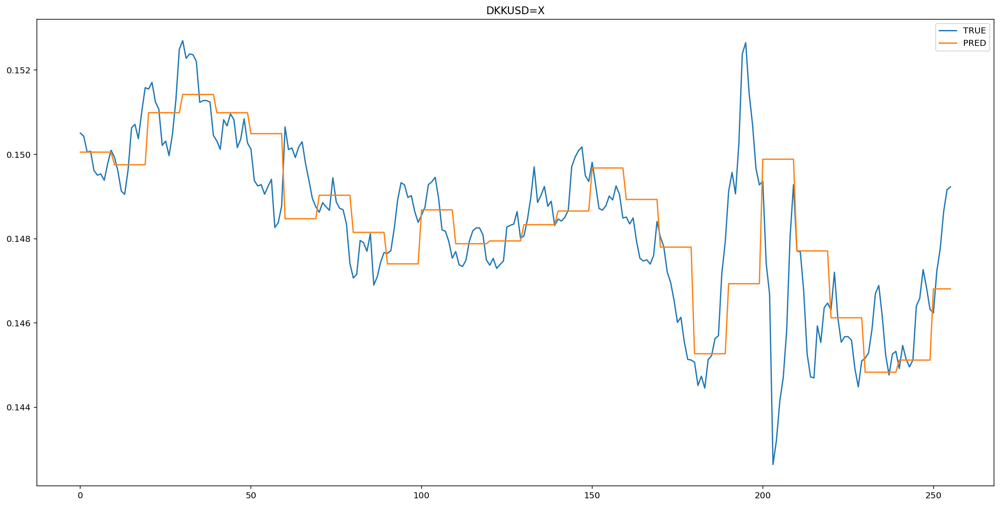

...

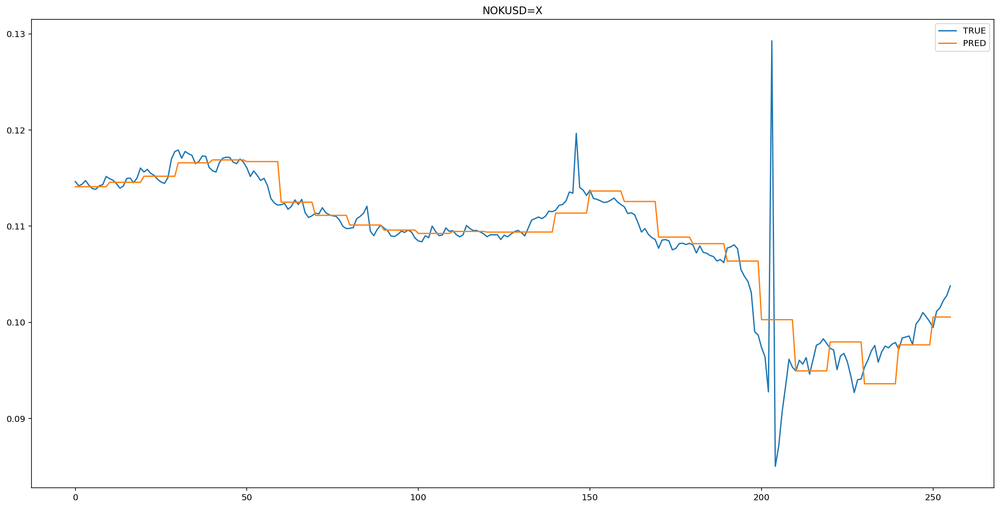

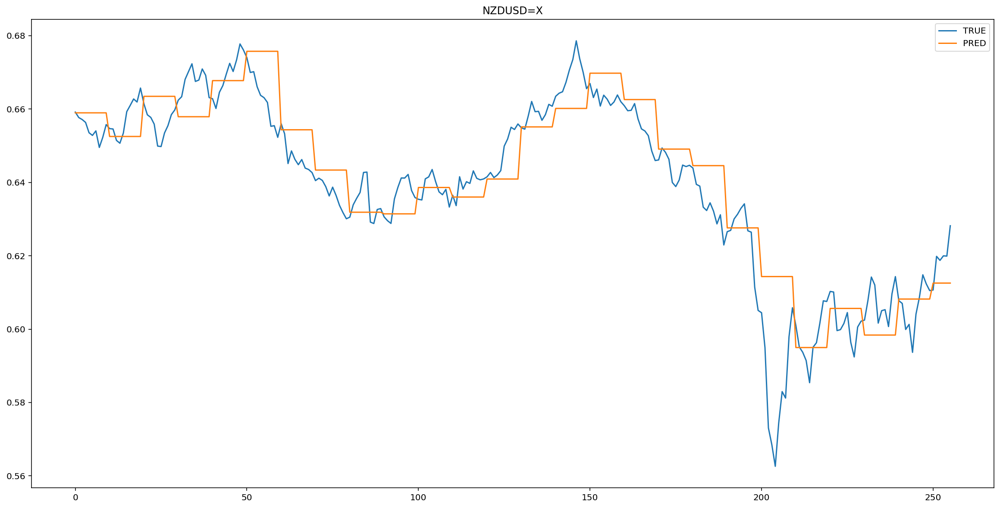

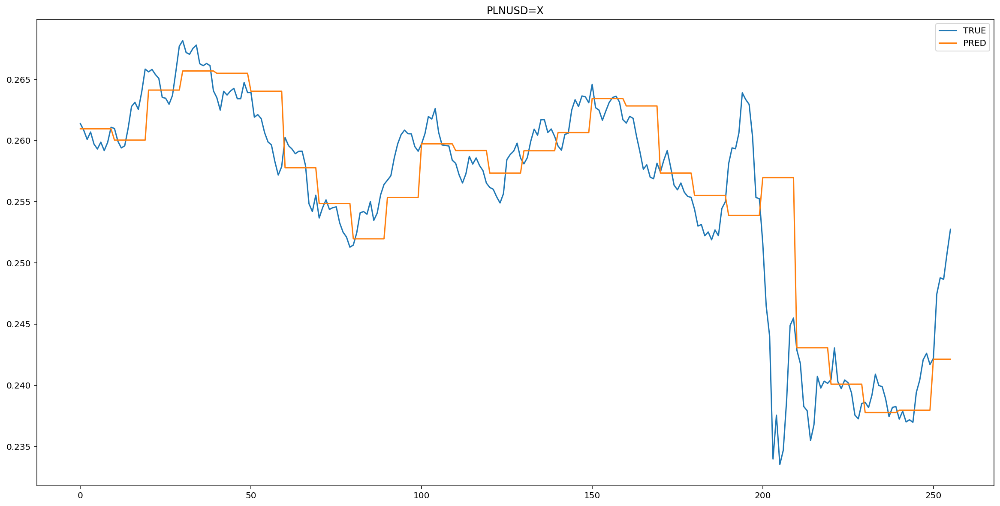

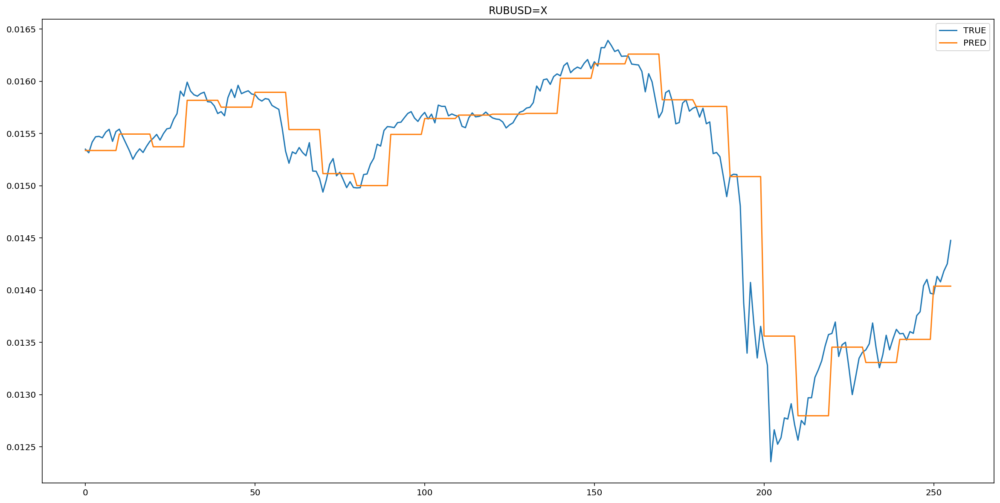

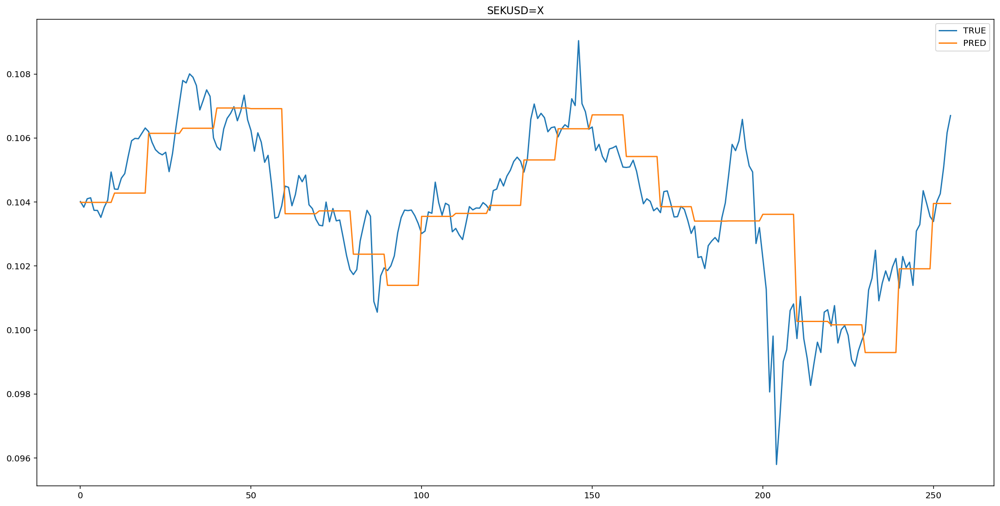

In [34]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [35]:
table.loc['mean'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [36]:
MSE(y_hat, y_pred)

7.106539e-05

In [37]:
RMSE(y_hat, y_pred)

0.008430029

In [38]:
MAE(y_hat, y_pred)

0.0038278026

###Скользящее среднее

####Вычисления

Составляем прогноз

In [39]:
y_pred = []
i = 0
n = 10

while len(y_pred) < len(test_y):
  temp_pred = test_X[i]
  for j in range(n):
    temp_pred = np.concatenate((temp_pred, np.array([temp_pred[-n:].mean(axis = 0)]))) #скользящее среднее
    y_pred.append(temp_pred[-1])
  i = i + n


Делаем обратное преобразование

In [40]:
y_pred = np.array(y_pred)[:len(test_y)]
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(y_pred)

Выводим график

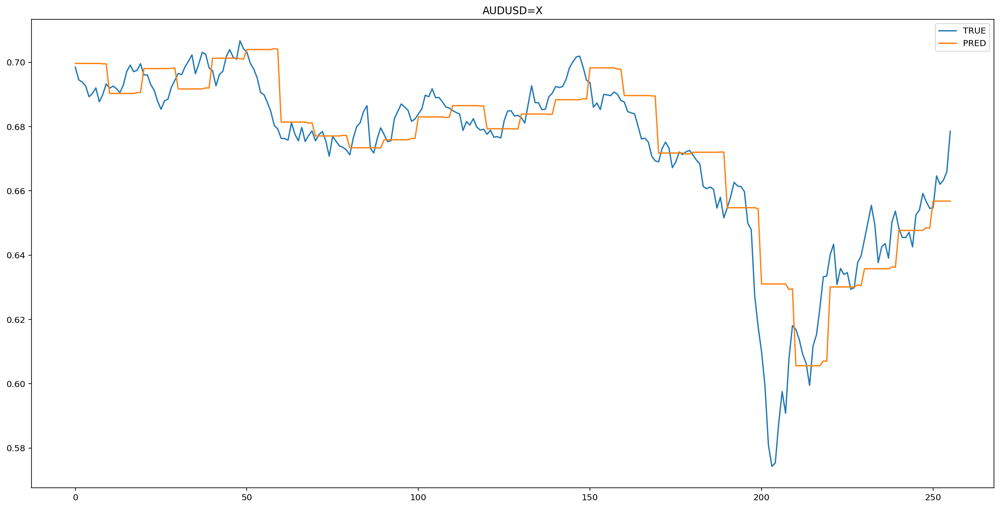

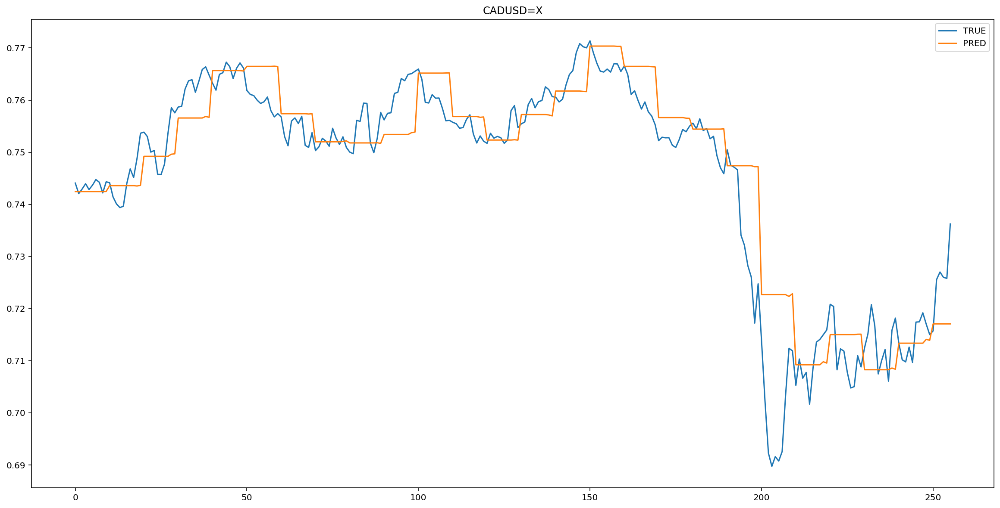

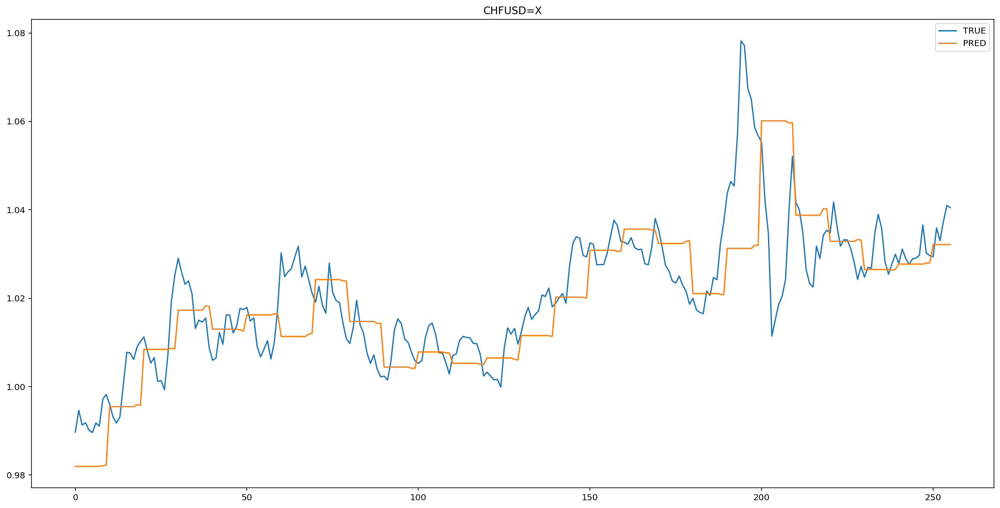

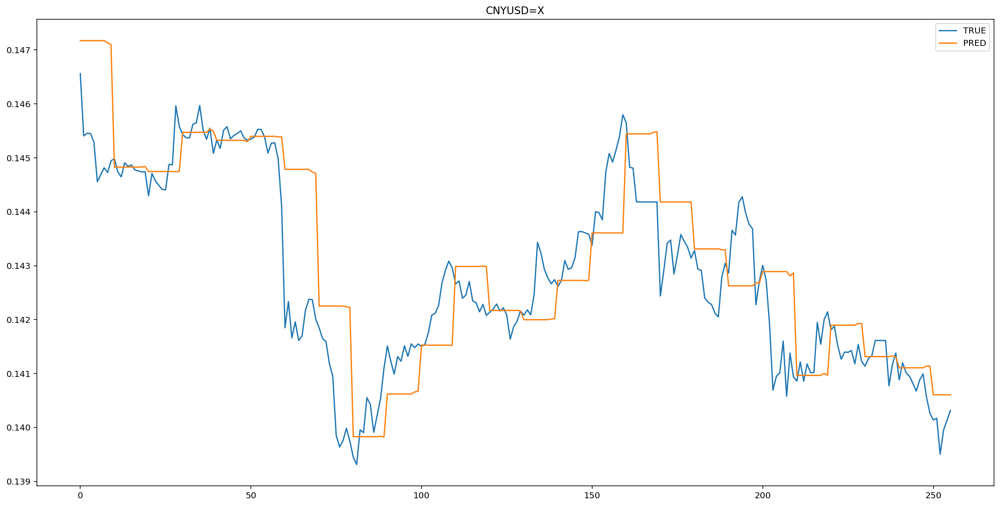

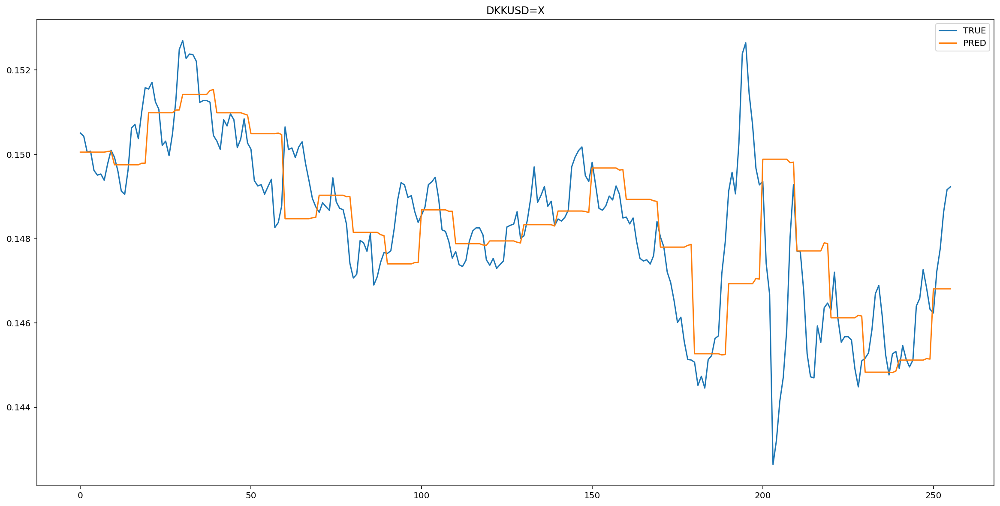

...

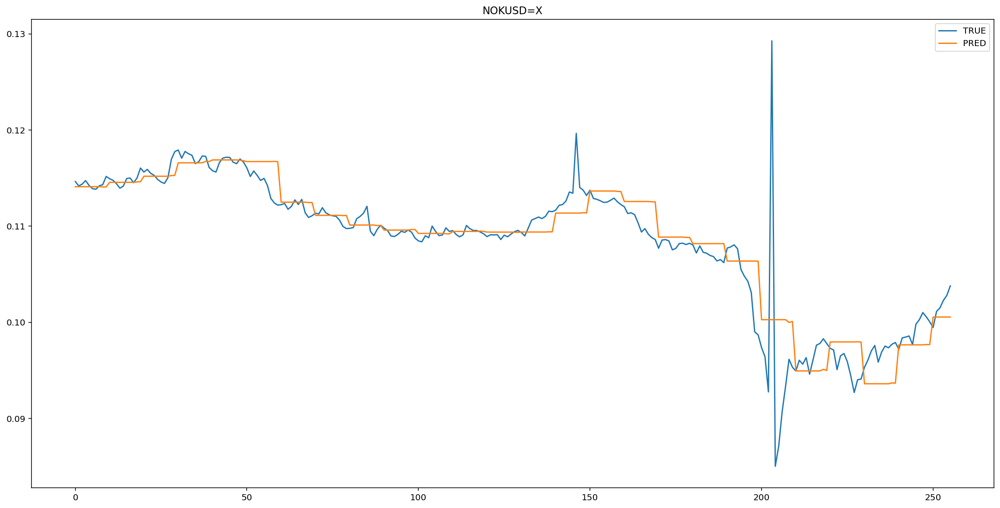

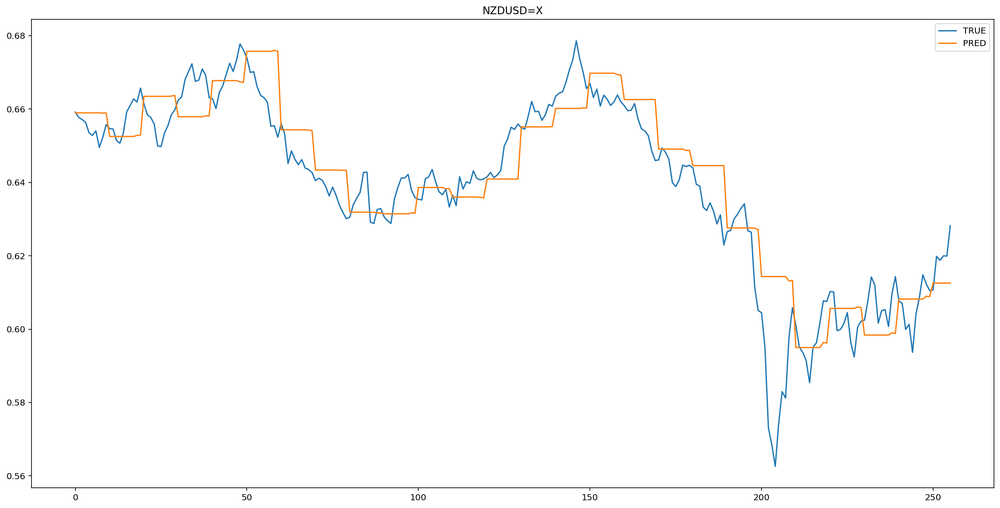

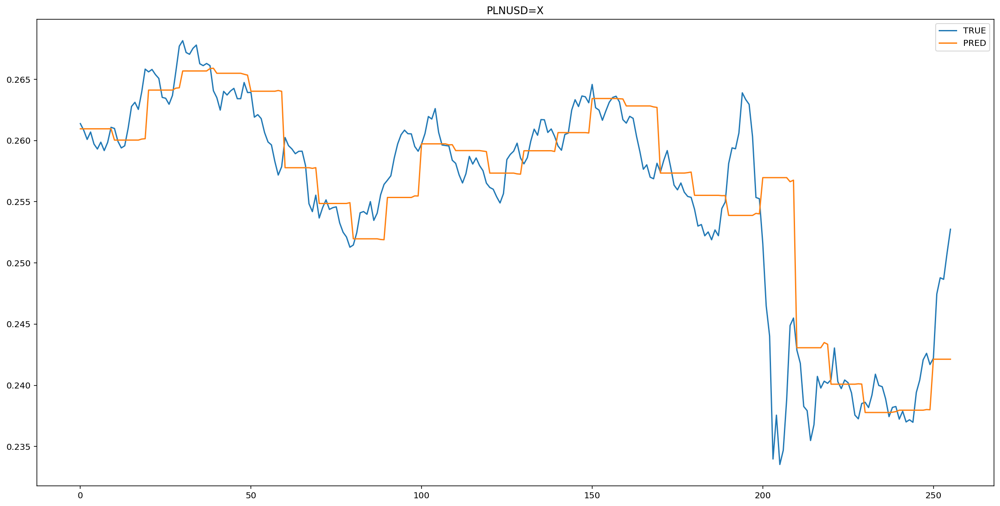

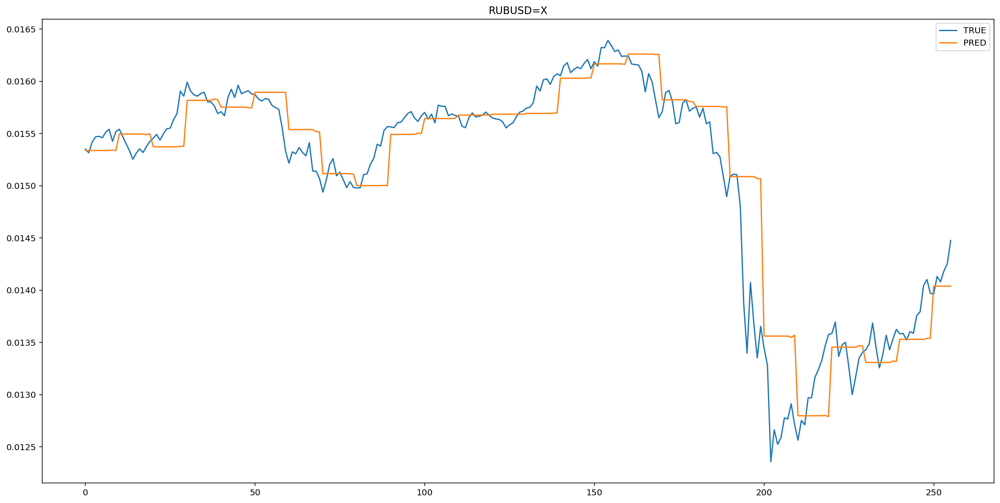

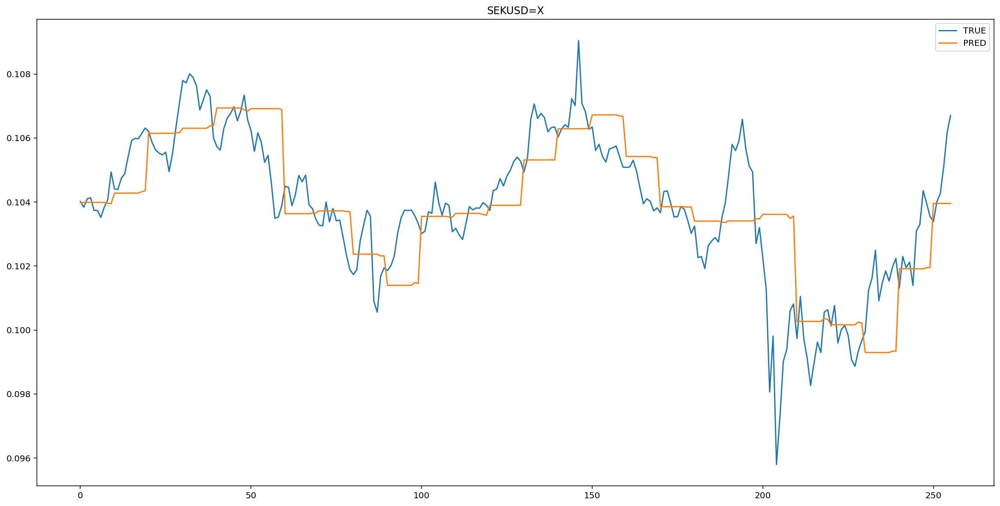

In [41]:
for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [42]:
table.loc['moving average'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [43]:
MSE(y_hat, y_pred)

7.0633825e-05

In [44]:
RMSE(y_hat, y_pred)

0.008404393

In [45]:
MAE(y_hat, y_pred)

0.0038162828

##Регрессия

Импортируем библиотеки

In [46]:
from sklearn.linear_model import Ridge, Lasso

###Простая линейная

Строим модель

In [47]:
linear_model = LinearRegression()
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

Считаем score

In [48]:
 linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9140473018607213

###Lasso

Строим модель

In [49]:
linear_model = Lasso(alpha=0.0001)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Lasso(alpha=0.0001, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

Считаем score

In [50]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9455366477565754

###Ridge

Строим модель

In [51]:
linear_model = Ridge(alpha=0.004)
linear_model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1]*train_X.shape[2]), train_y)

Ridge(alpha=0.004, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001)

Считаем score

In [52]:
linear_model.score(test_X.reshape(test_X.shape[0], test_X.shape[1]*test_X.shape[2]), test_y)

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:434: FutureWarning: The default value of multioutput (not exposed in score method) will change from 'variance_weighted' to 'uniform_average' in 0.23 to keep consistent with 'metrics.r2_score'. To specify the default value manually and avoid the warning, please either call 'metrics.r2_score' directly or make a custom scorer with 'metrics.make_scorer' (the built-in scorer 'r2' uses multioutput='uniform_average').
  "multioutput='uniform_average').", FutureWarning)


0.9190165073227986

##ARIMA

###ARIMA

###SARIMAX

###VAR

####Вычисления

In [53]:
from statsmodels.tsa.api import VAR 

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [54]:
model = VAR(train_y)

In [55]:
results = model.fit(ic='aic') 

In [56]:
y_pred = []

for i in range(len(test_X)):
  y_pred.append(results.forecast(test_X[i], 1)[0])
y_pred = scaler.inverse_transform(np.array(y_pred))
y_hat = scaler.inverse_transform(test_y)

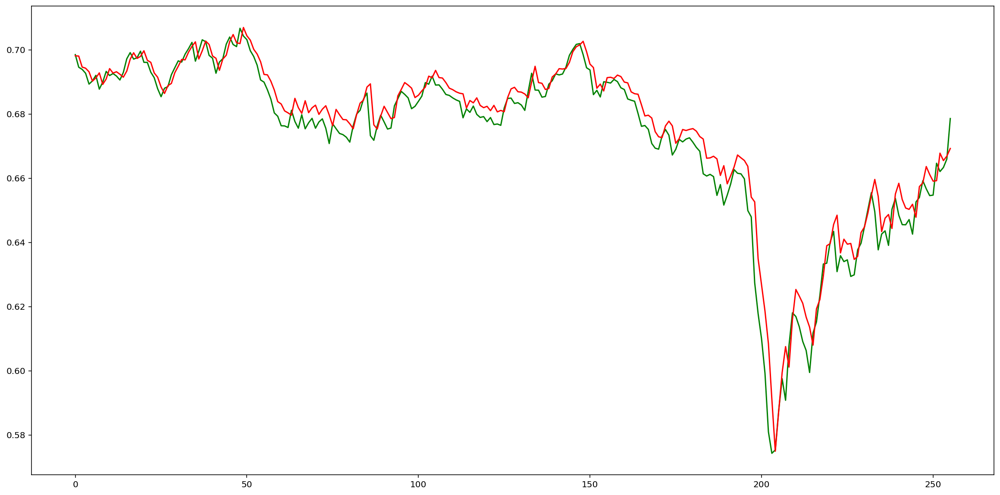

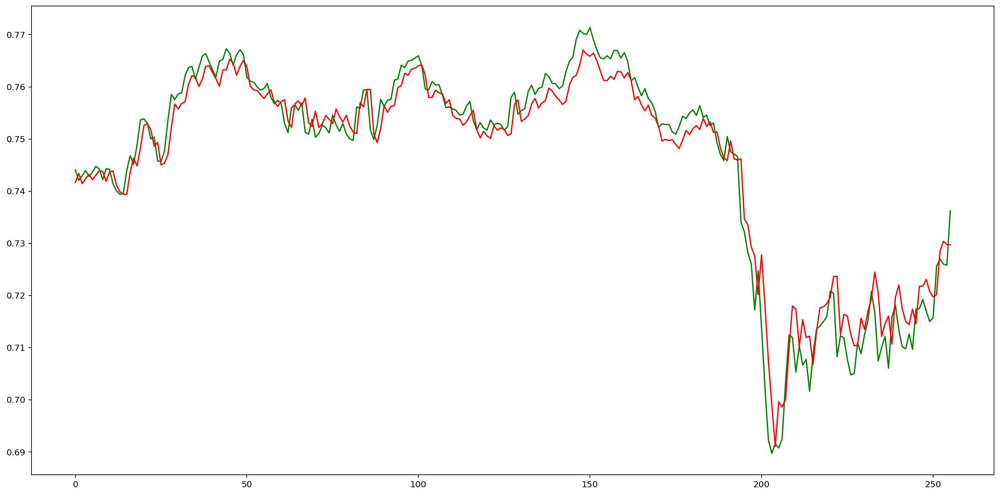

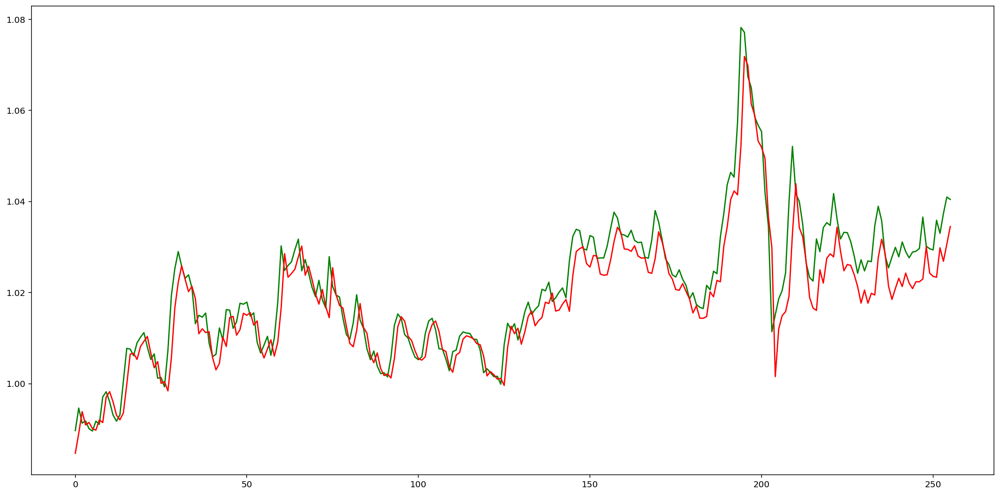

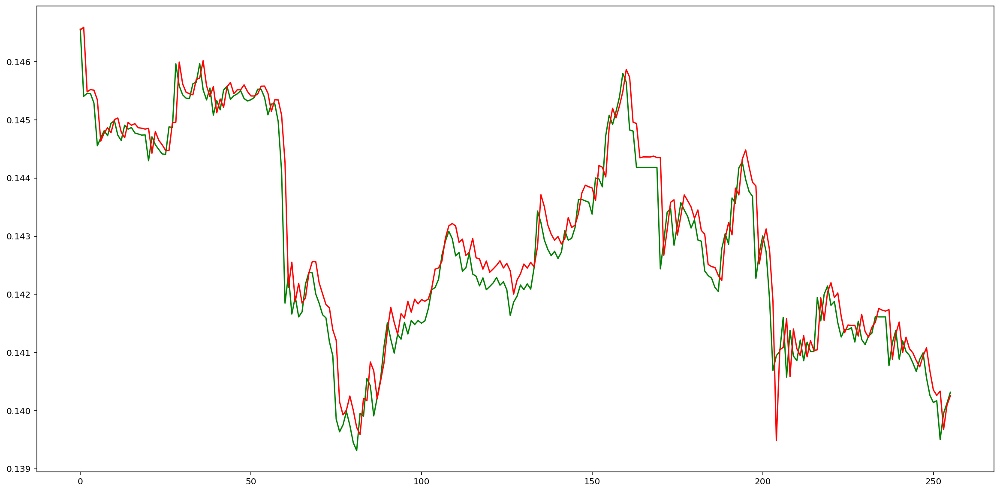

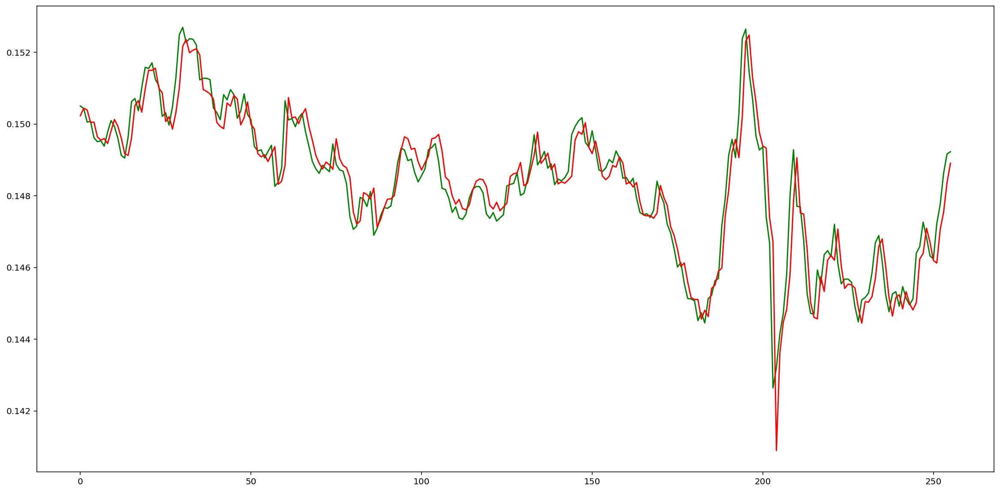

...

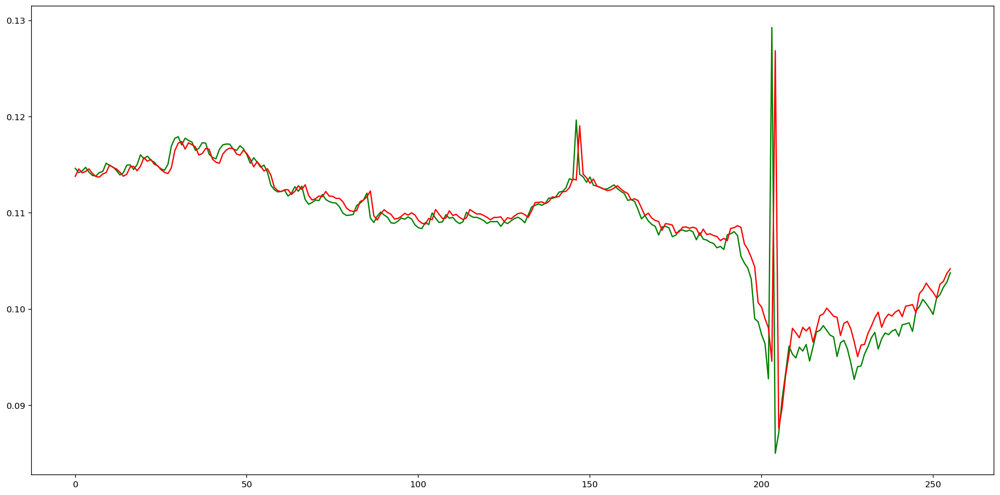

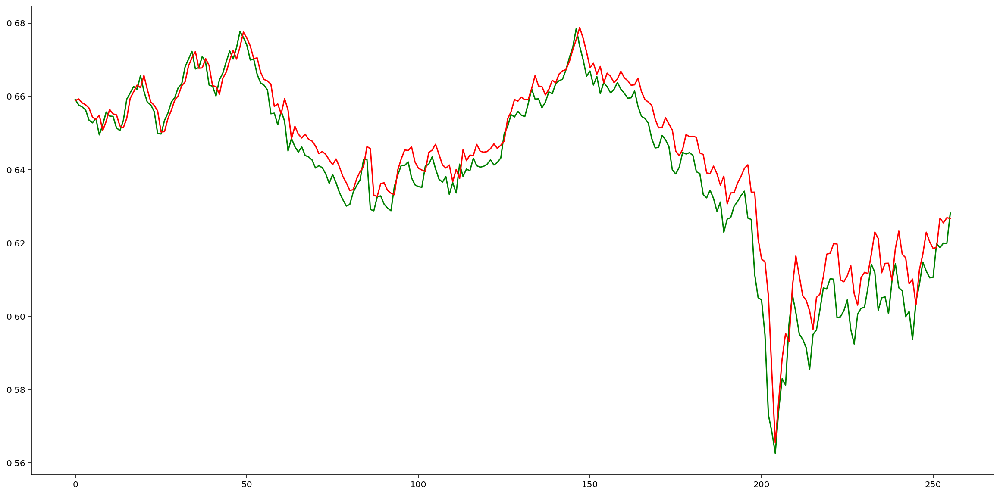

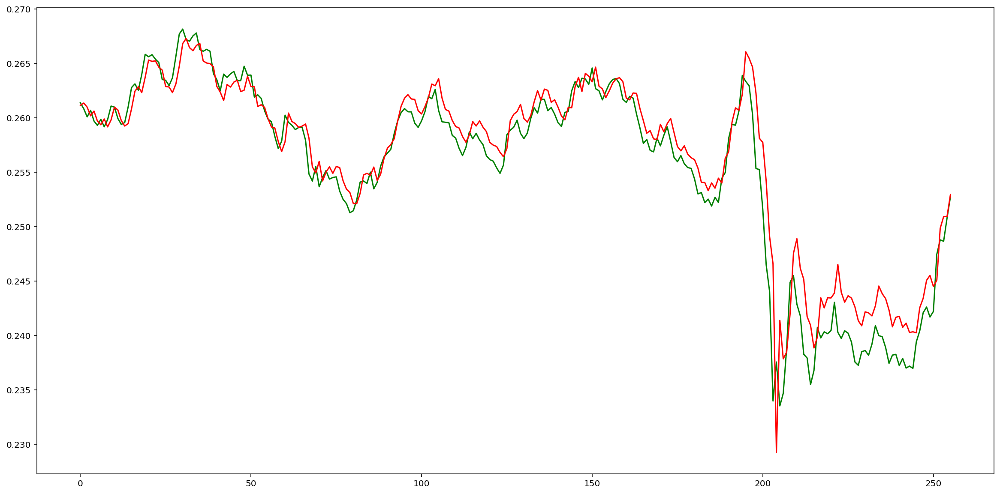

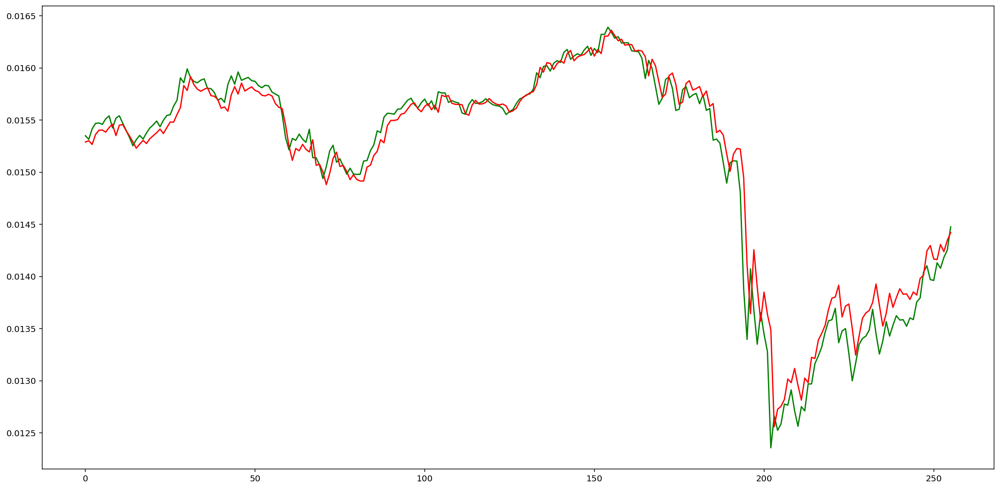

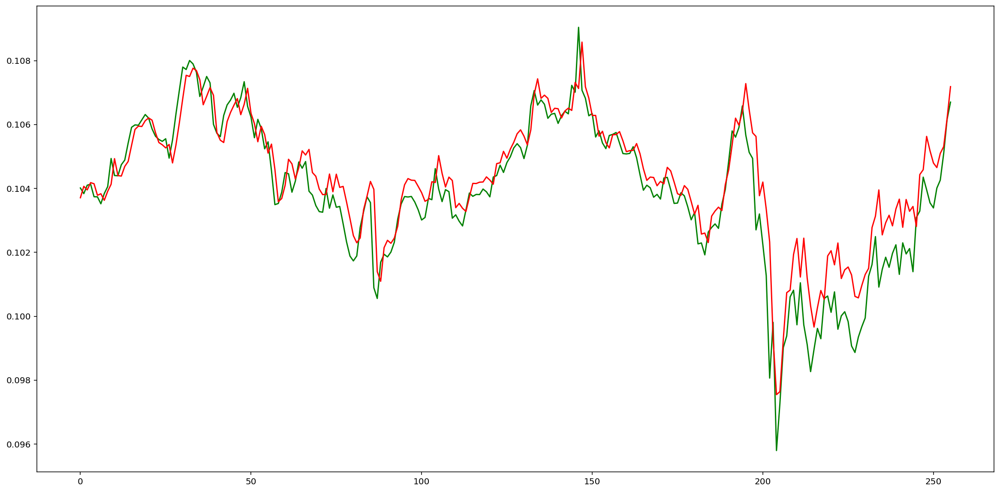

In [57]:
for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.plot(y_hat[:, i], color='green')
    plt.plot(y_pred[:, i], color='red')

####Оцениваем точность

In [58]:
table.loc['VAR'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [59]:
MSE(y_hat, y_pred)

2.1993701887944522e-05

In [60]:
RMSE(y_hat, y_pred)

0.00468974433076522

In [61]:
MAE(y_hat, y_pred)

0.0022954843817325618

###VARIMAX

####Оцениваем точность

In [62]:
MSE(y_hat, y_pred)

2.1993701887944522e-05

In [63]:
RMSE(y_hat, y_pred)

0.00468974433076522

In [64]:
MAE(y_hat, y_pred)

0.0022954843817325618

##Нейронные сети

###Перцептрон

####Вычисления

In [65]:
 # design network
model = Sequential()
model.add(Dense(128, input_shape=(train_X.shape[1], train_X.shape[2]), activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Flatten())
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 1s - loss: 0.4054 - val_loss: 0.0988
Epoch 2/100
5/5 - 0s - loss: 0.0932 - val_loss: 0.0500
Epoch 3/100
5/5 - 0s - loss: 0.0378 - val_loss: 0.0661
Epoch 4/100
5/5 - 0s - loss: 0.0461 - val_loss: 0.0514
Epoch 5/100
5/5 - 0s - loss: 0.0236 - val_loss: 0.0440
Epoch 6/100
5/5 - 0s - loss: 0.0228 - val_loss: 0.0423
Epoch 7/100
5/5 - 0s - loss: 0.0203 - val_loss: 0.0403
Epoch 8/100
5/5 - 0s - loss: 0.0149 - val_loss: 0.0413
Epoch 9/100
5/5 - 0s - loss: 0.0133 - val_loss: 0.0424
Epoch 10/100
5/5 - 0s - loss: 0.0115 - val_loss: 0.0416
Epoch 11/100
5/5 - 0s - loss: 0.0098 - val_loss: 0.0405
Epoch 12/100
5/5 - 0s - loss: 0.0090 - val_loss: 0.0395
Epoch 13/100
5/5 - 0s - loss: 0.0078 - val_loss: 0.0392
Epoch 14/100
5/5 - 0s - loss: 0.0069 - val_loss: 0.0391
Epoch 15/100
5/5 - 0s - loss: 0.0064 - val_loss: 0.0385
Epoch 16/100
5/5 - 0s - loss: 0.0060 - val_loss: 0.0377
Epoch 17/100
5/5 - 0s - loss: 0.0057 - val_loss: 0.0372
Epoch 18/100
5/5 - 0s - loss: 0.0055 - val_loss: 0.0369
E

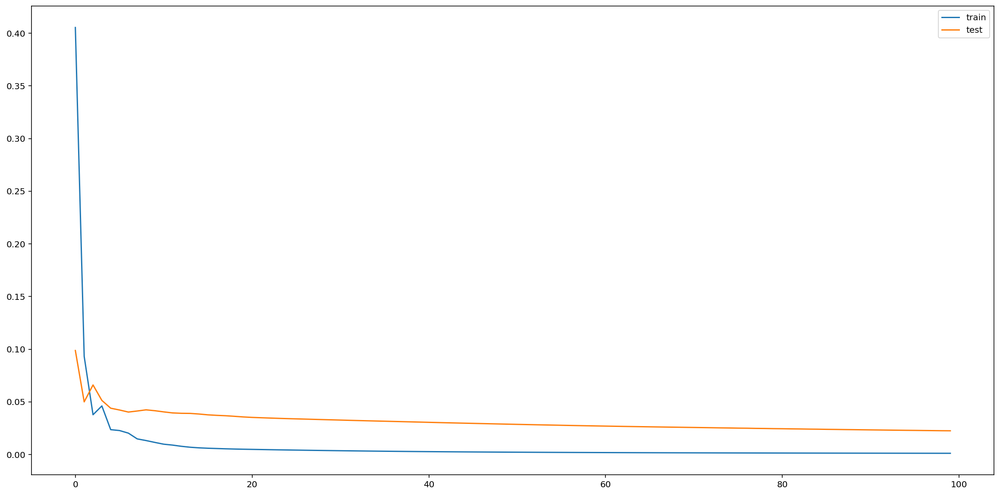

In [66]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [67]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

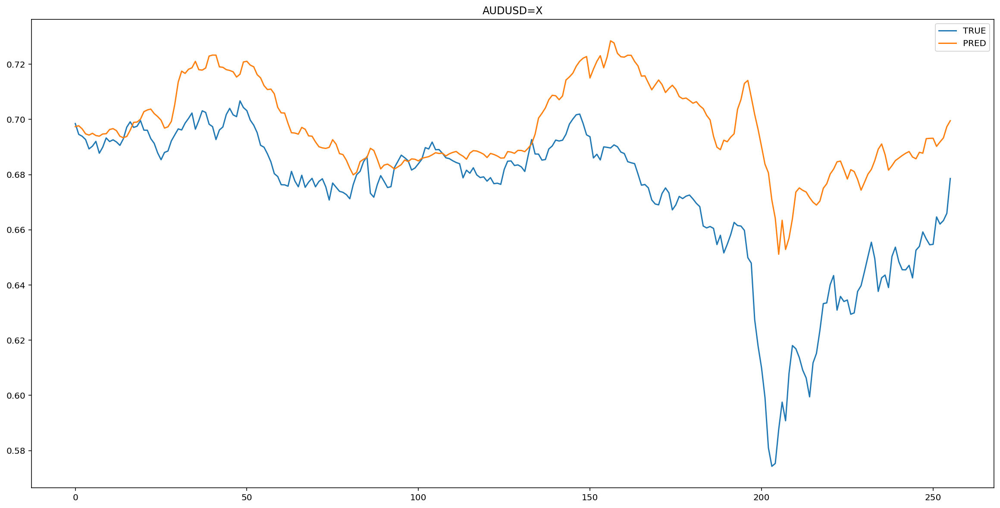

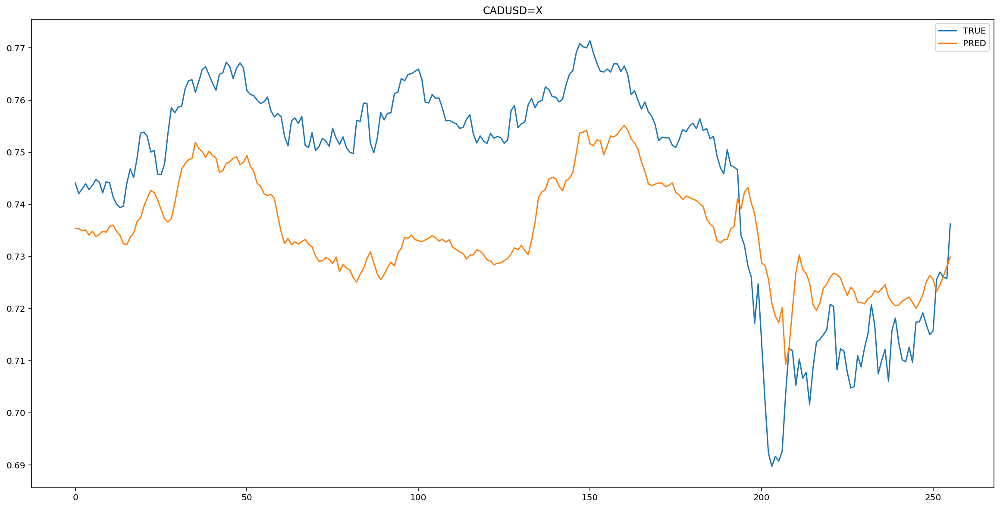

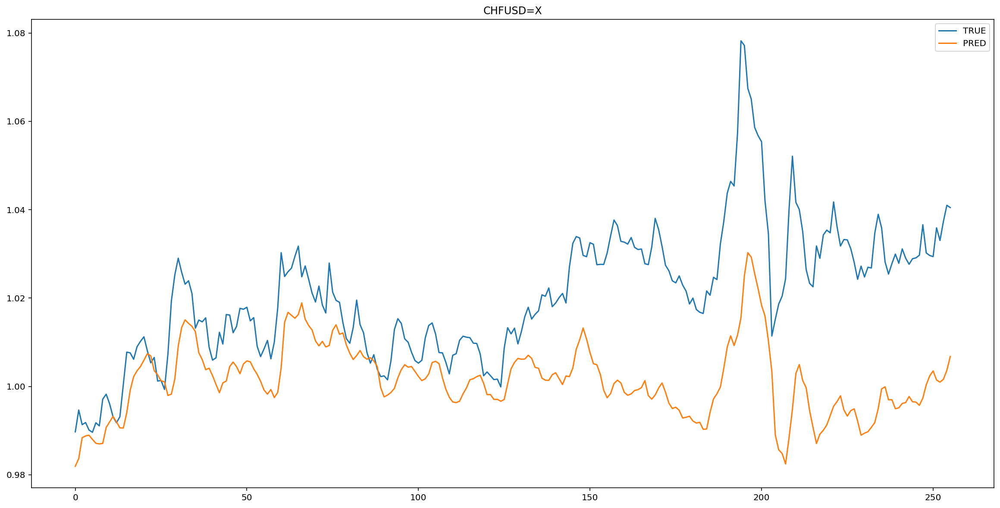

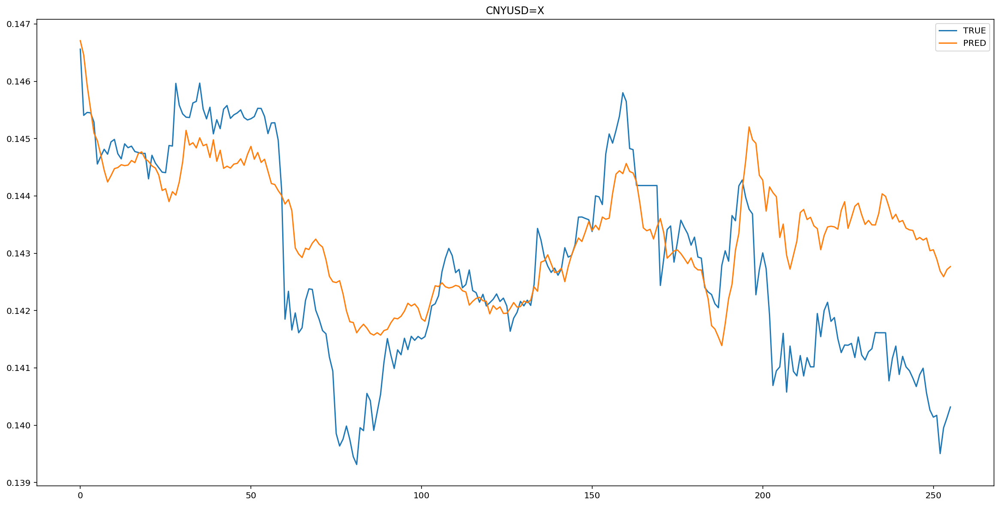

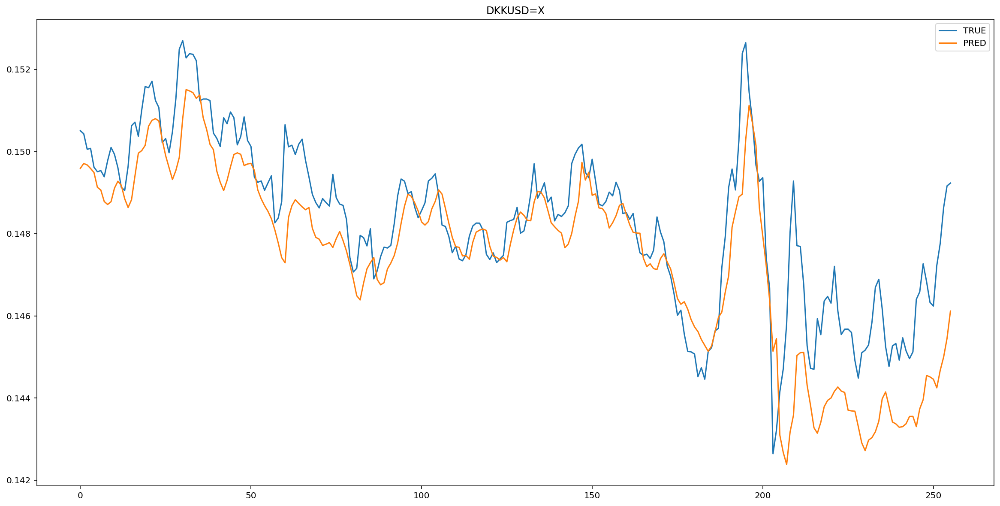

...

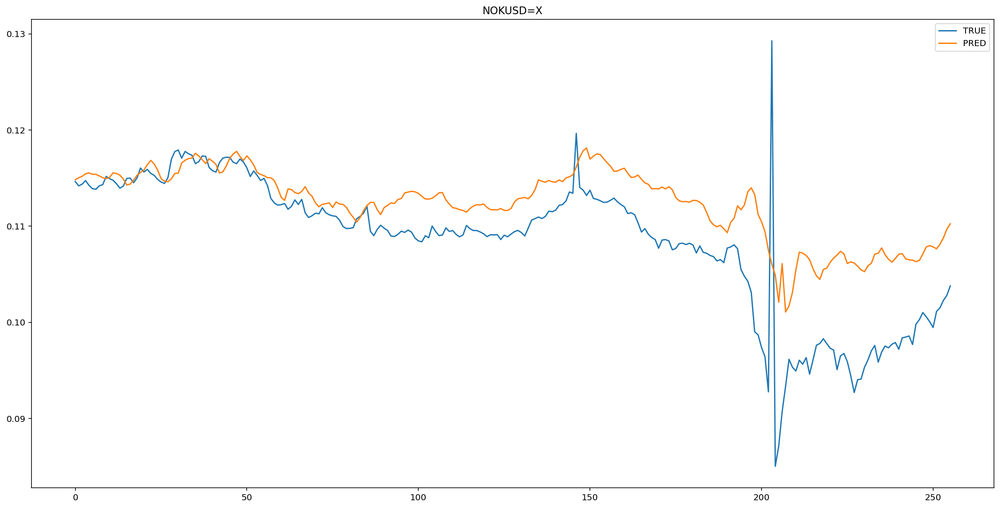

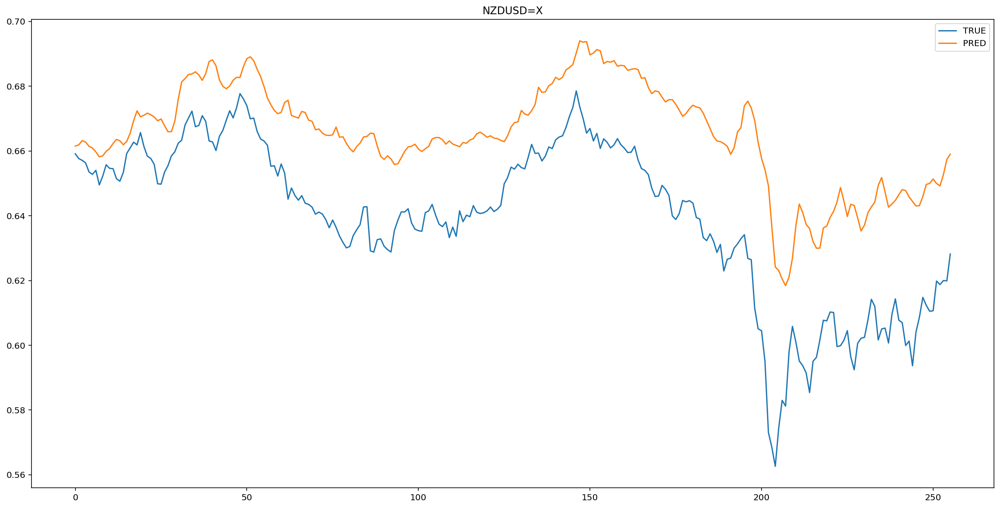

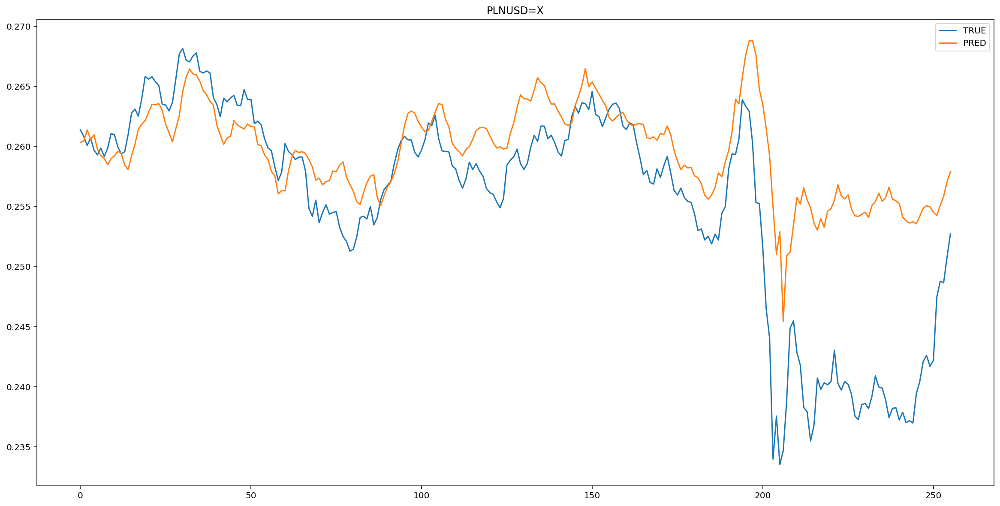

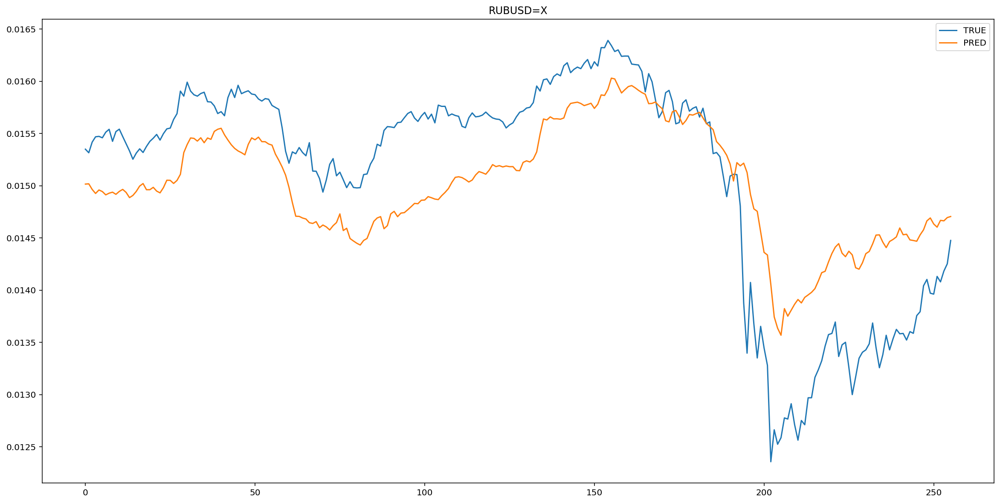

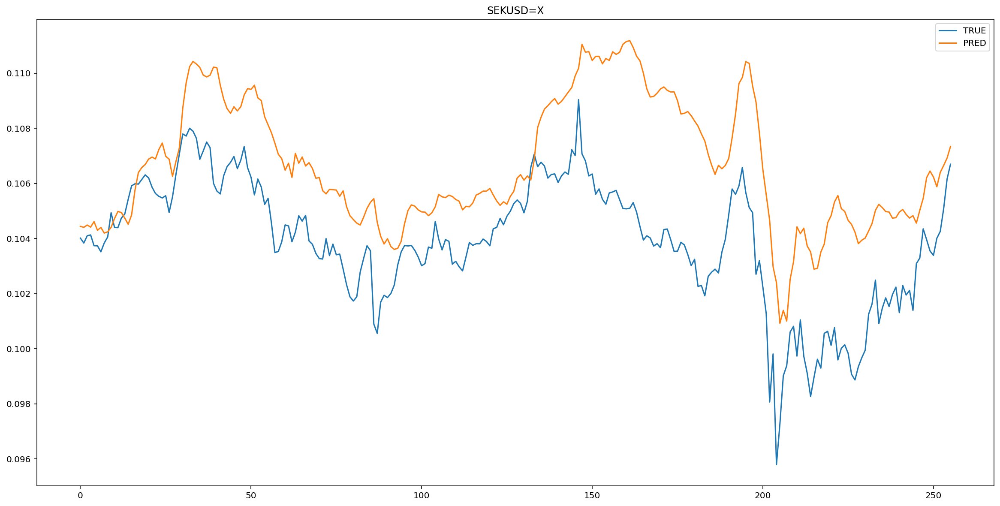

In [68]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [69]:
table.loc['Perc'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [70]:
MSE(y_hat, y_pred)

0.0002694591

In [71]:
RMSE(y_hat, y_pred)

0.016415209

In [72]:
MAE(y_hat, y_pred)

0.009343962

###Свёрточные

####Вычисления

In [73]:
train_X, test_X, valid_X, train_y, test_y, valid_y = split(train_X.shape[2], 1, 0.6, 0.15)

In [74]:
 # design network

model = Sequential()
model.add(Conv2D(128, (8, 8) ,input_shape=(train_X.shape[1], train_X.shape[2], 1), activation='relu'))

model.add(MaxPooling2D(pool_size=(8, 8)))
model.add(Conv2D(32, (1, 1),activation='relu'))
model.add(MaxPooling2D(pool_size=(1, 1)))

model.add(Flatten())

model.add(Dense(64,activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(train_y.shape[1],activation='relu'))

model.compile(loss='mse', optimizer='adam')

In [75]:
 train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1).shape

(603, 15, 15, 1)

Epoch 1/100
4/4 - 2s - loss: 0.3256 - val_loss: 0.1098
Epoch 2/100
4/4 - 0s - loss: 0.2360 - val_loss: 0.0705
Epoch 3/100
4/4 - 0s - loss: 0.2217 - val_loss: 0.0630
Epoch 4/100
4/4 - 0s - loss: 0.1926 - val_loss: 0.0646
Epoch 5/100
4/4 - 0s - loss: 0.1751 - val_loss: 0.0528
Epoch 6/100
4/4 - 0s - loss: 0.1645 - val_loss: 0.0401
Epoch 7/100
4/4 - 0s - loss: 0.1526 - val_loss: 0.0368
Epoch 8/100
4/4 - 0s - loss: 0.1435 - val_loss: 0.0358
Epoch 9/100
4/4 - 0s - loss: 0.1386 - val_loss: 0.0321
Epoch 10/100
4/4 - 0s - loss: 0.1266 - val_loss: 0.0249
Epoch 11/100
4/4 - 0s - loss: 0.1279 - val_loss: 0.0225
Epoch 12/100
4/4 - 0s - loss: 0.1187 - val_loss: 0.0242
Epoch 13/100
4/4 - 0s - loss: 0.1219 - val_loss: 0.0223
Epoch 14/100
4/4 - 0s - loss: 0.1109 - val_loss: 0.0188
Epoch 15/100
4/4 - 0s - loss: 0.1087 - val_loss: 0.0188
Epoch 16/100
4/4 - 0s - loss: 0.1051 - val_loss: 0.0196
Epoch 17/100
4/4 - 0s - loss: 0.1033 - val_loss: 0.0187
Epoch 18/100
4/4 - 0s - loss: 0.0987 - val_loss: 0.0180
E

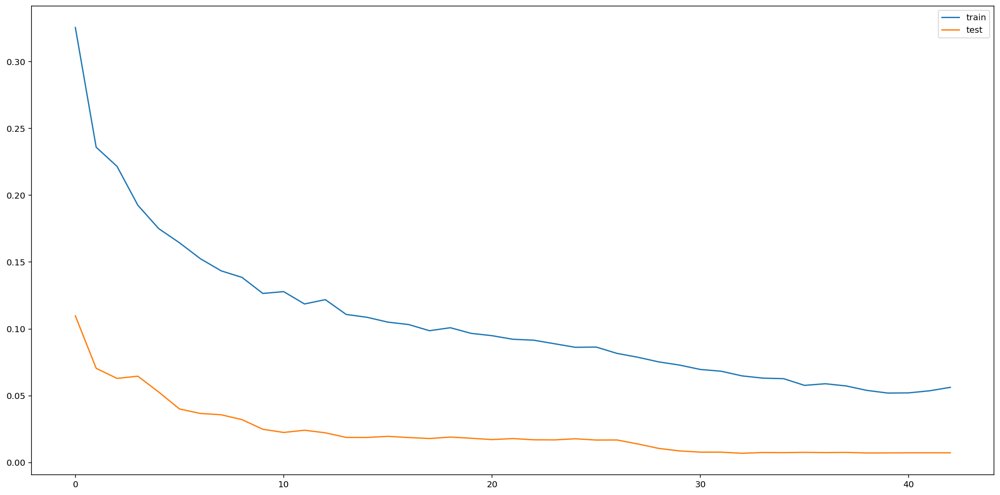

In [76]:
# fit network
#history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False)
#history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y, epochs=100, batch_size=128, validation_data=(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1), test_y), verbose=2, shuffle=False)

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y,\
                    epochs=100, batch_size=128,validation_split=0.25,\
                    verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [77]:
model.evaluate(train_X.reshape(train_X.shape[0], train_X.shape[1], train_X.shape[2], 1), train_y)

19/19 [==============================] - 0s 3ms/step - loss: 0.0179


0.017868973314762115

In [78]:
y_hat = scaler.inverse_transform(test_y)
#y_pred = scaler.inverse_transform(model.predict(test_X))
y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

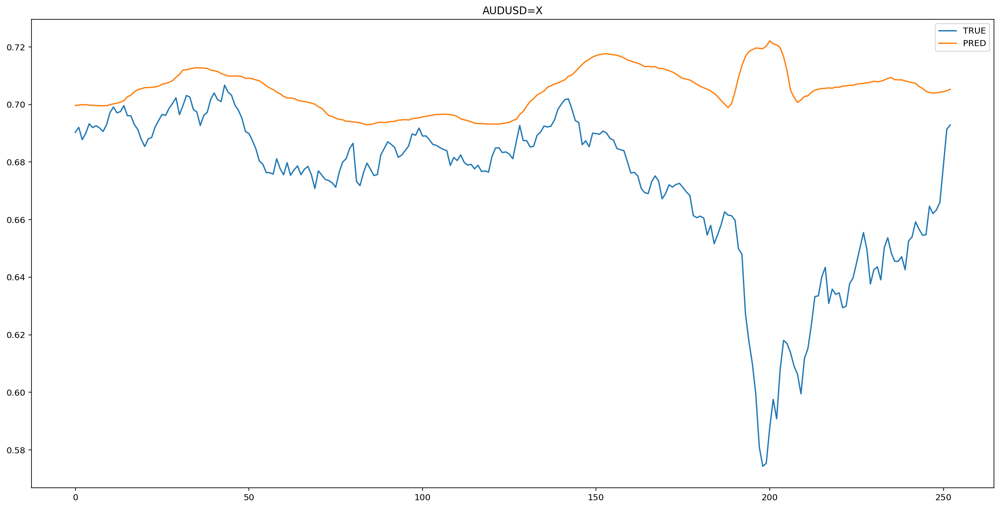

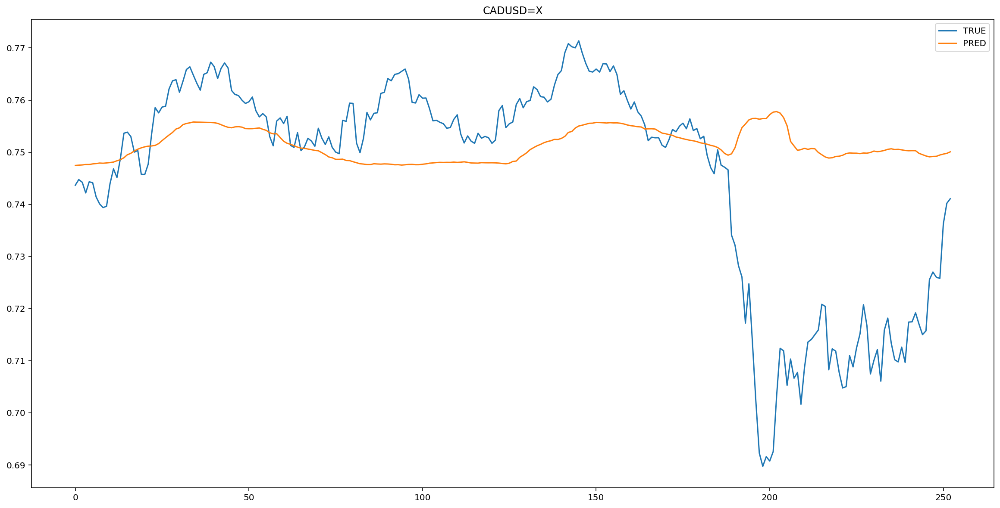

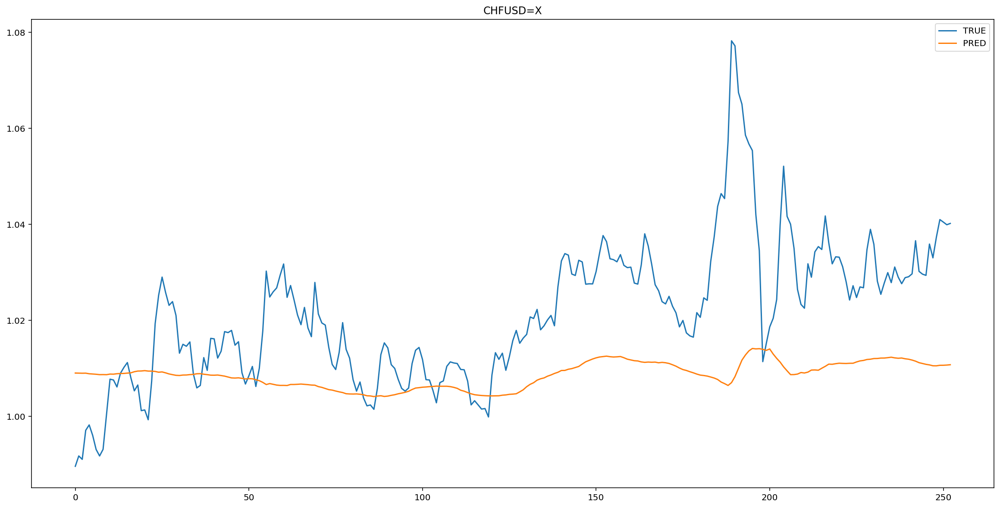

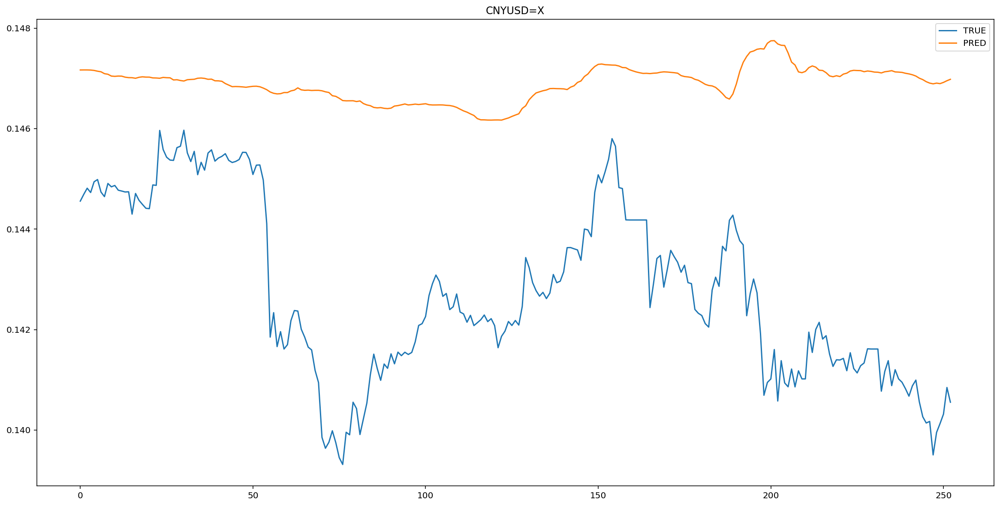

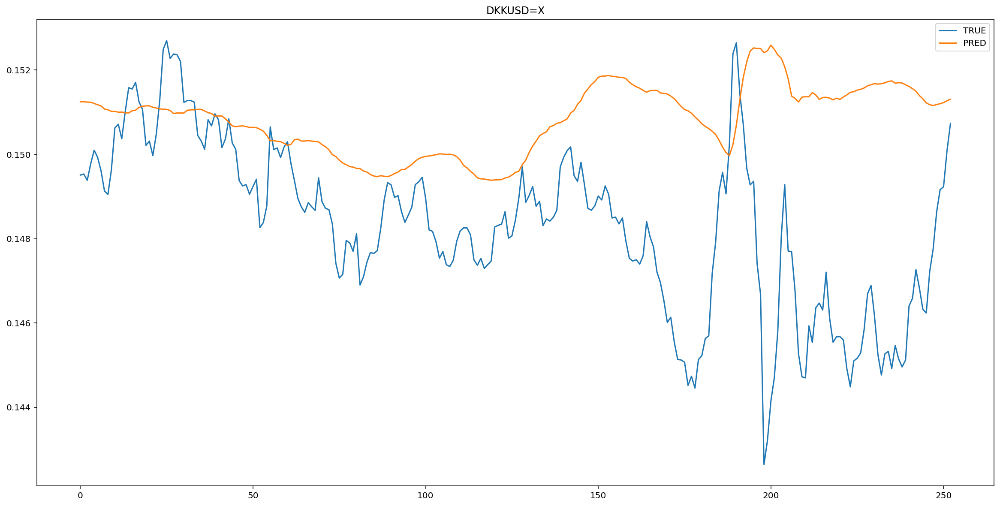

...

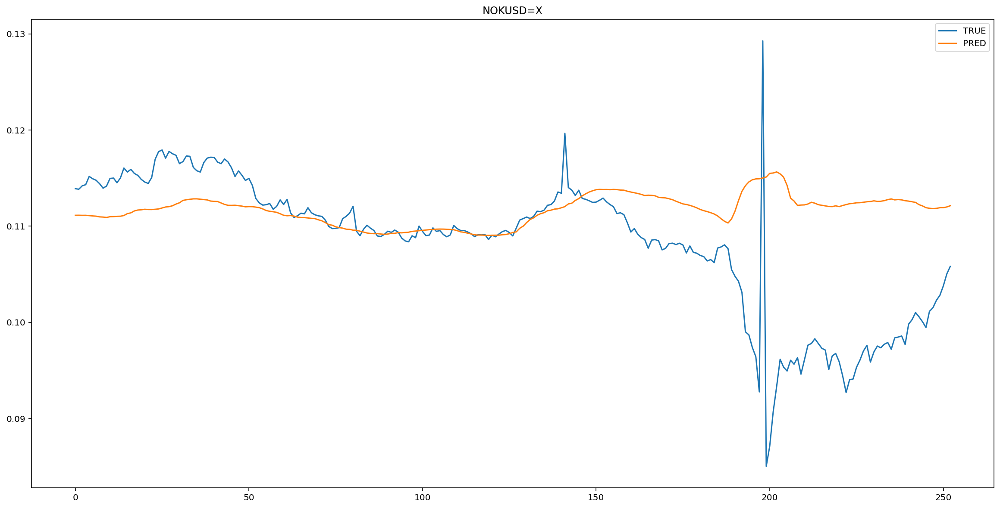

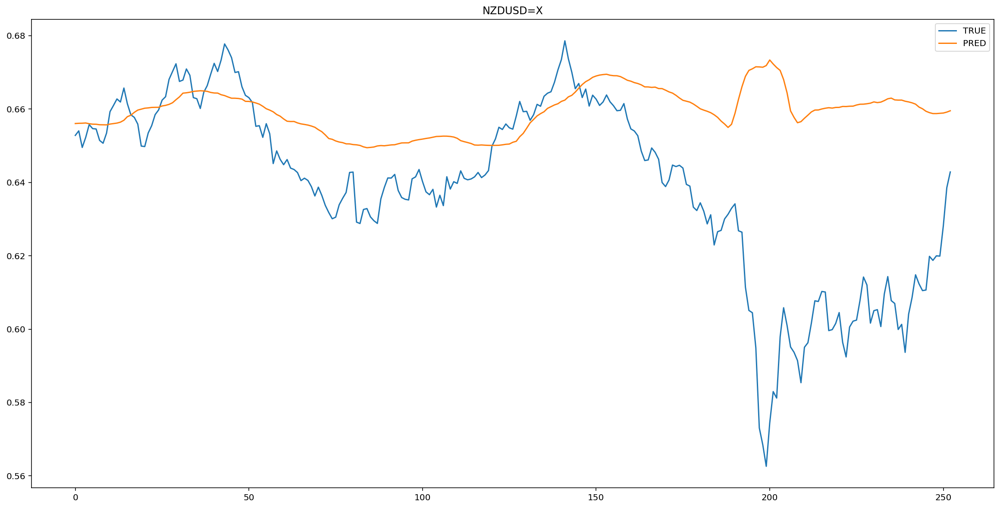

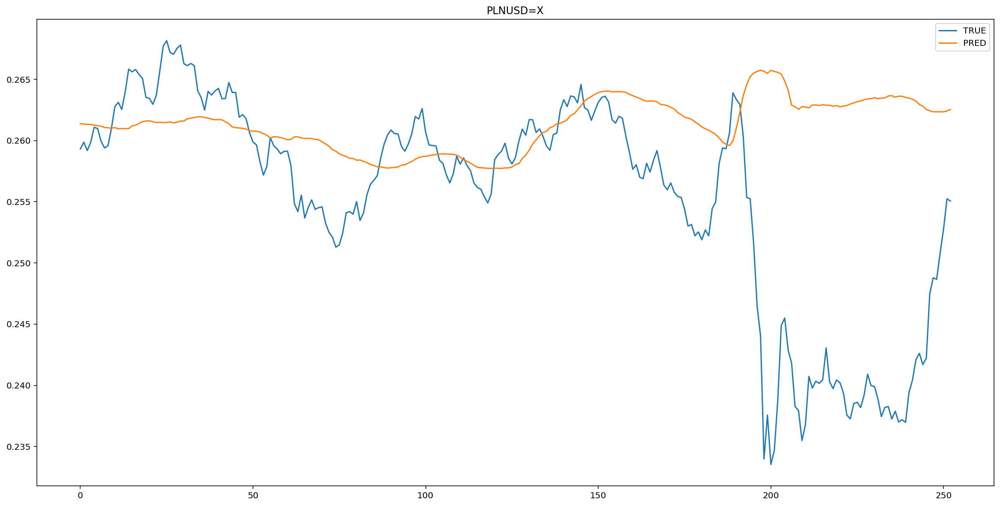

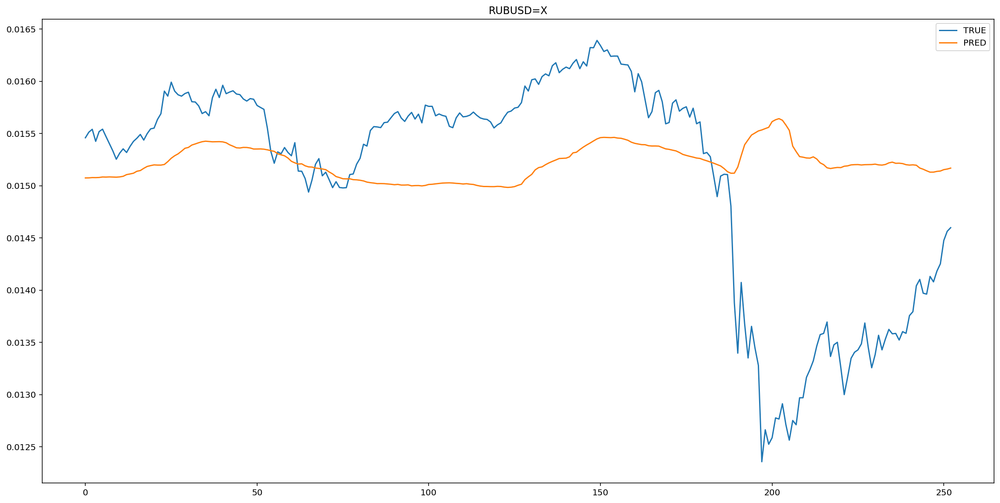

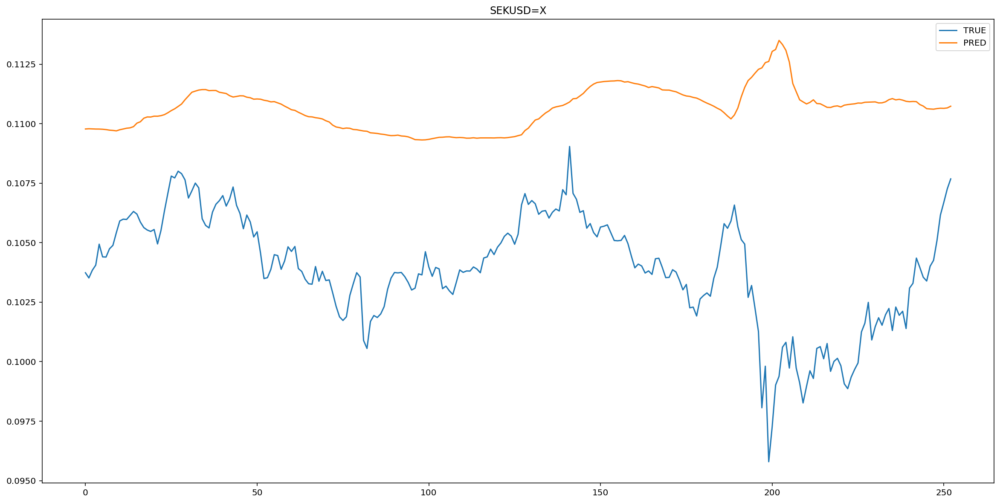

In [79]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

####Оцениваем точность

In [80]:
table.loc['Conv'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [81]:
MSE(y_hat, y_pred)

0.0004131905

In [82]:
RMSE(y_hat, y_pred)

0.020327087

In [83]:
MAE(y_hat, y_pred)

0.010934187

###Рекуррентные

In [84]:
train_X, test_X, valid_X, train_y, test_y, valid_y = split(3, 1, 0.6, 0.15)

####RNN

#####Вычисления

In [85]:
# design network
model = Sequential()
model.add(SimpleRNN(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(SimpleRNN(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 1s - loss: 0.2685 - val_loss: 0.0821
Epoch 2/100
5/5 - 0s - loss: 0.0556 - val_loss: 0.0638
Epoch 3/100
5/5 - 0s - loss: 0.0311 - val_loss: 0.0481
Epoch 4/100
5/5 - 0s - loss: 0.0245 - val_loss: 0.0420
Epoch 5/100
5/5 - 0s - loss: 0.0177 - val_loss: 0.0432
Epoch 6/100
5/5 - 0s - loss: 0.0133 - val_loss: 0.0434
Epoch 7/100
5/5 - 0s - loss: 0.0106 - val_loss: 0.0434
Epoch 8/100
5/5 - 0s - loss: 0.0091 - val_loss: 0.0427
Epoch 9/100
5/5 - 0s - loss: 0.0073 - val_loss: 0.0412
Epoch 10/100
5/5 - 0s - loss: 0.0062 - val_loss: 0.0404
Epoch 11/100
5/5 - 0s - loss: 0.0054 - val_loss: 0.0389
Epoch 12/100
5/5 - 0s - loss: 0.0051 - val_loss: 0.0382
Epoch 13/100
5/5 - 0s - loss: 0.0048 - val_loss: 0.0375
Epoch 14/100
5/5 - 0s - loss: 0.0044 - val_loss: 0.0368
Epoch 15/100
5/5 - 0s - loss: 0.0042 - val_loss: 0.0362
Epoch 16/100
5/5 - 0s - loss: 0.0040 - val_loss: 0.0355
Epoch 17/100
5/5 - 0s - loss: 0.0038 - val_loss: 0.0353
Epoch 18/100
5/5 - 0s - loss: 0.0036 - val_loss: 0.0347
E

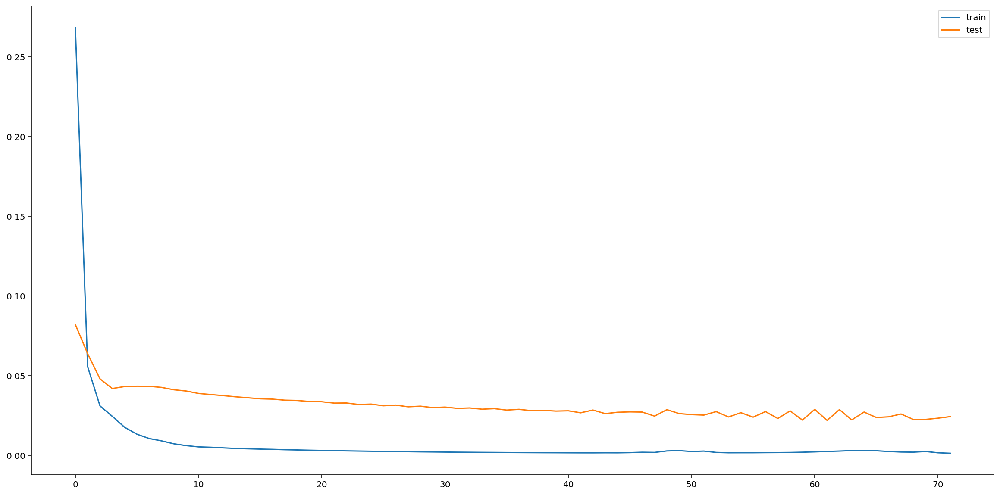

In [86]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [87]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

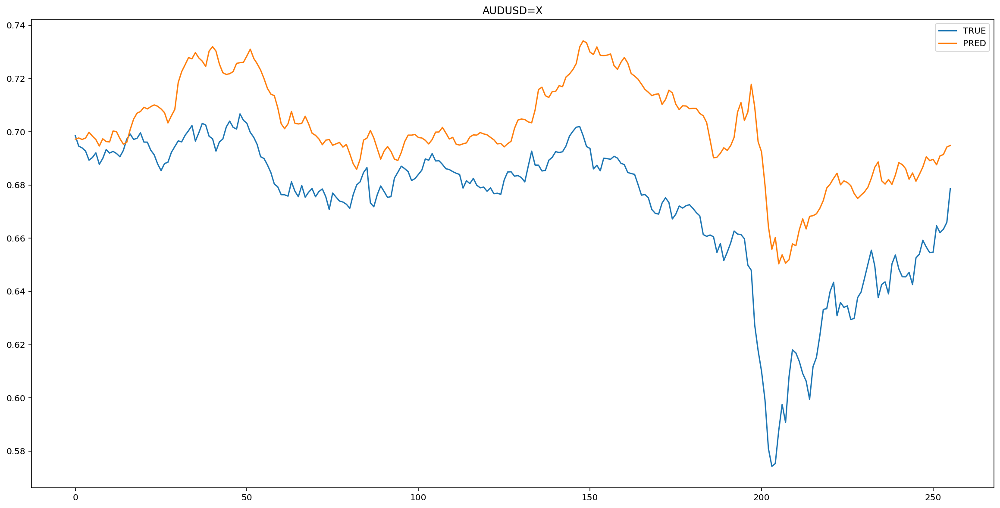

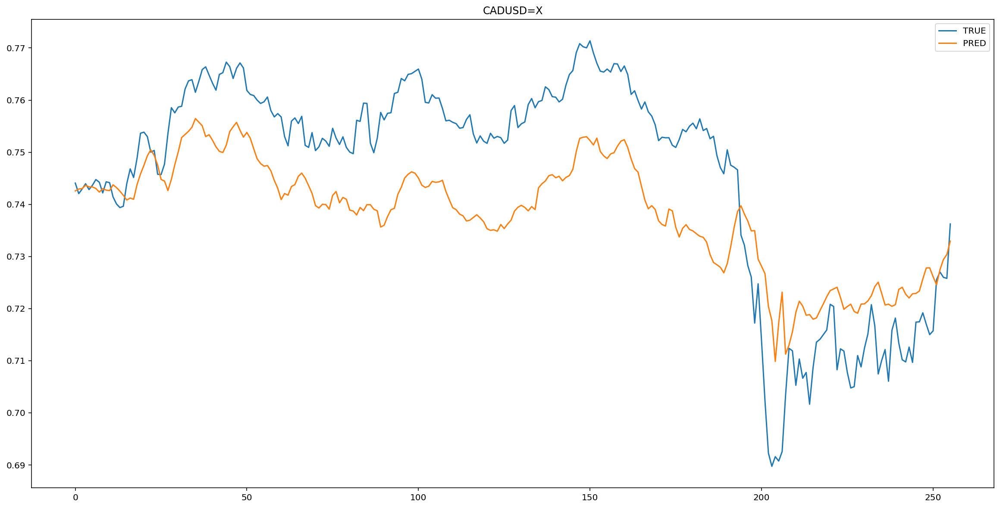

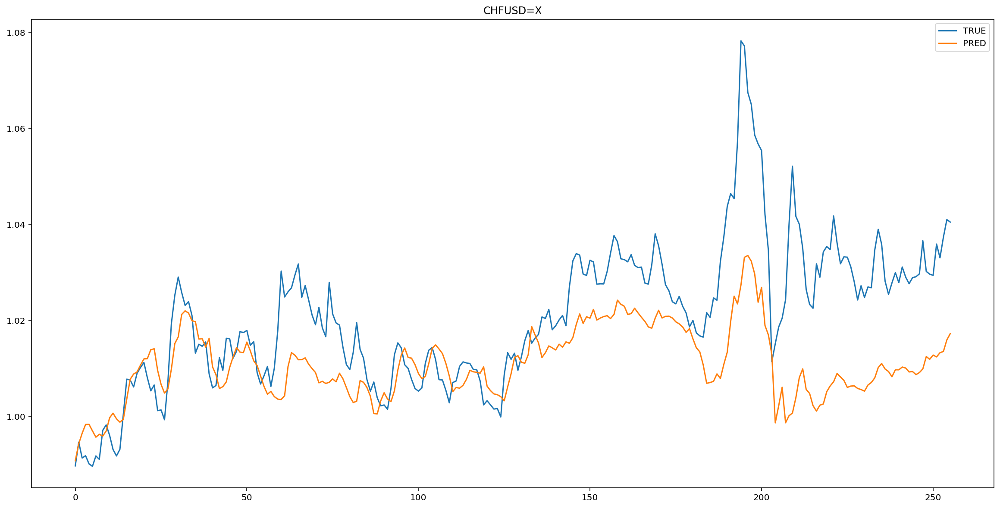

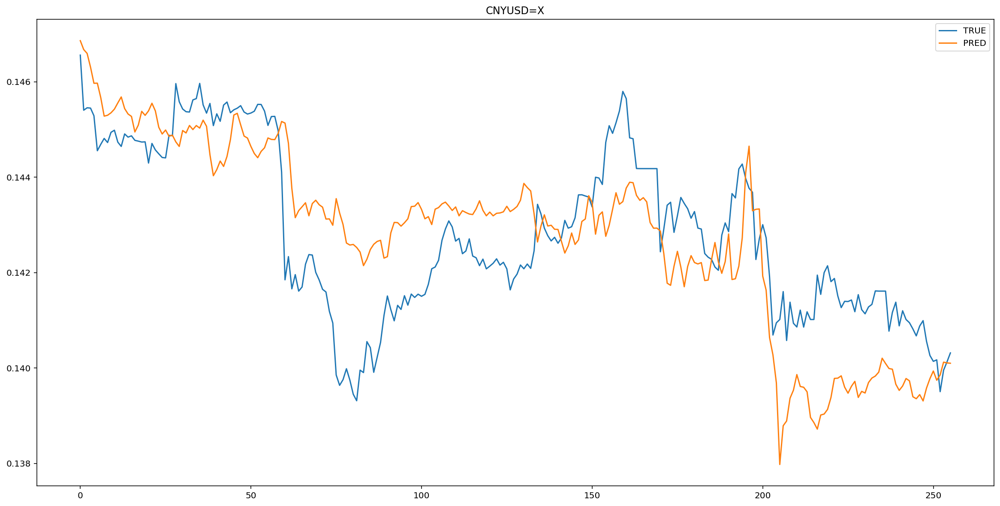

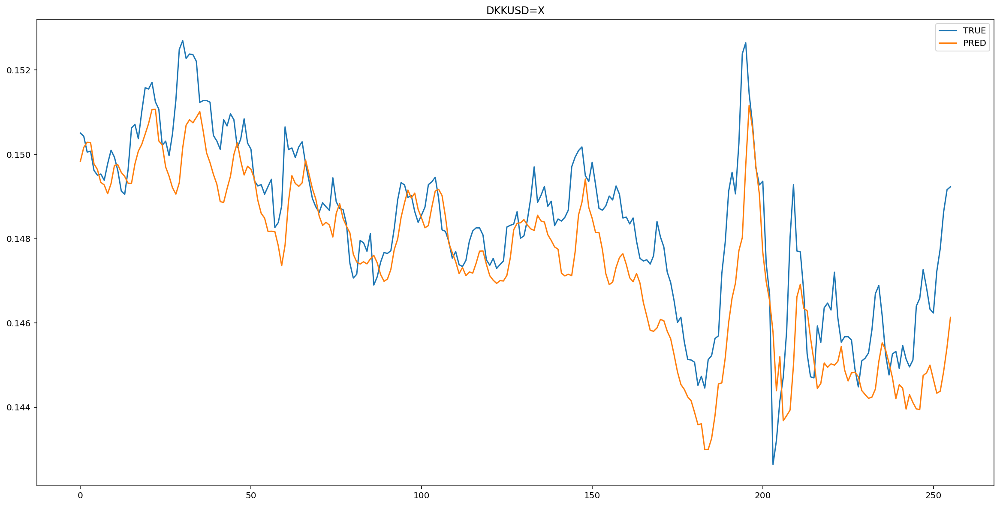

...

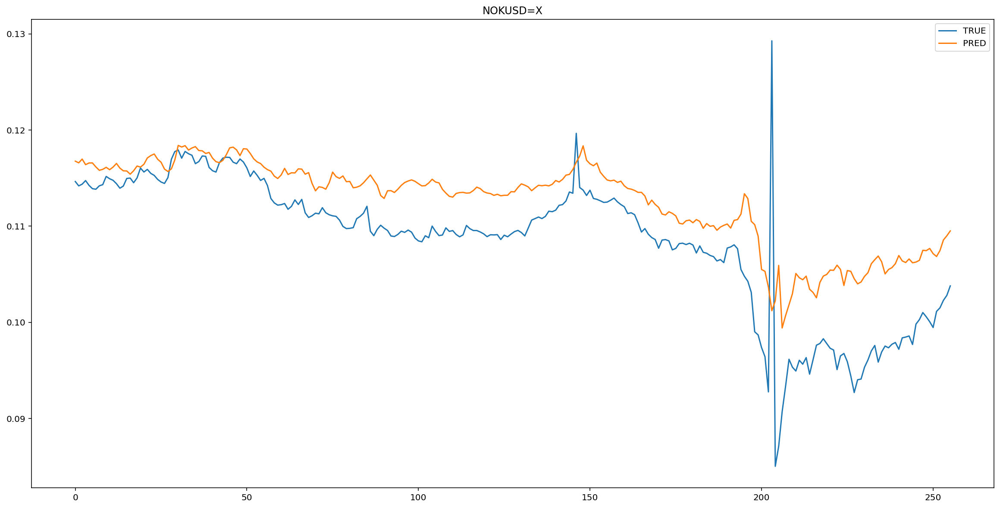

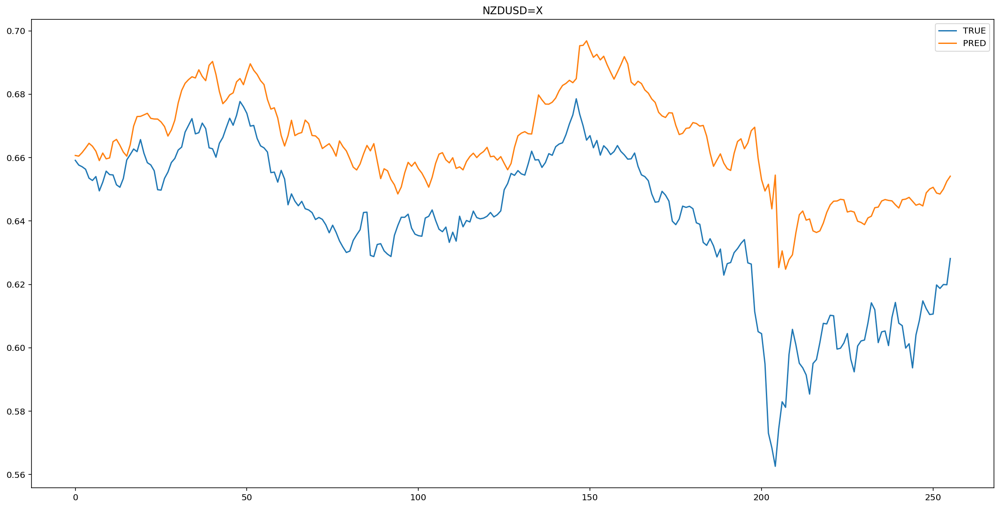

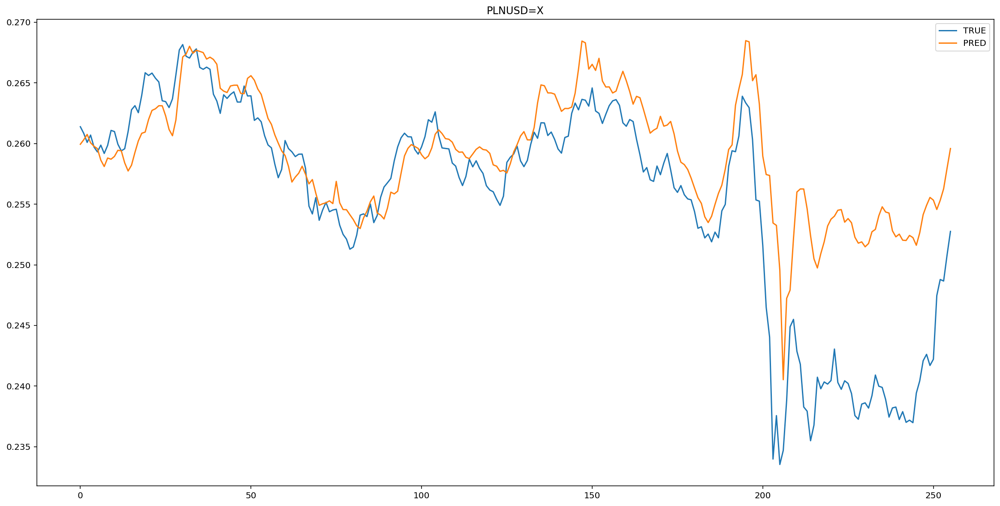

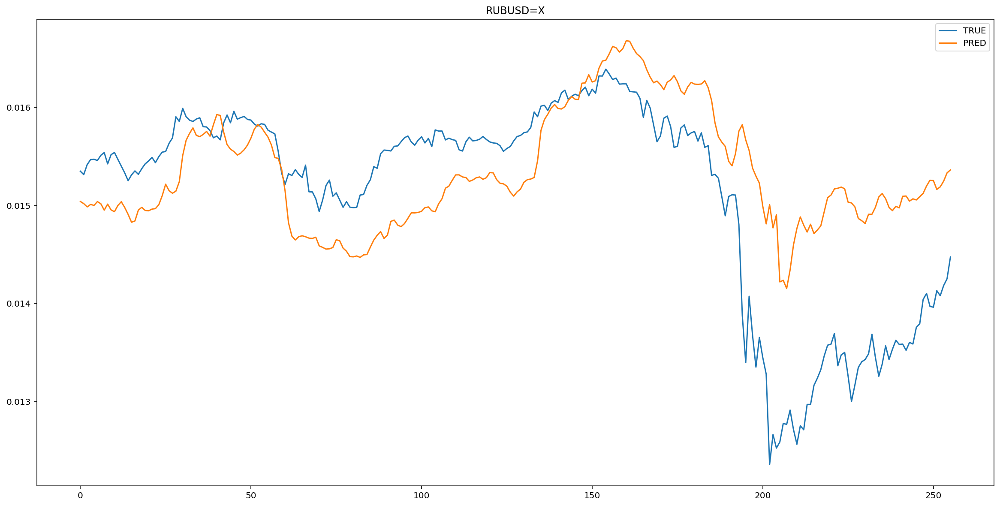

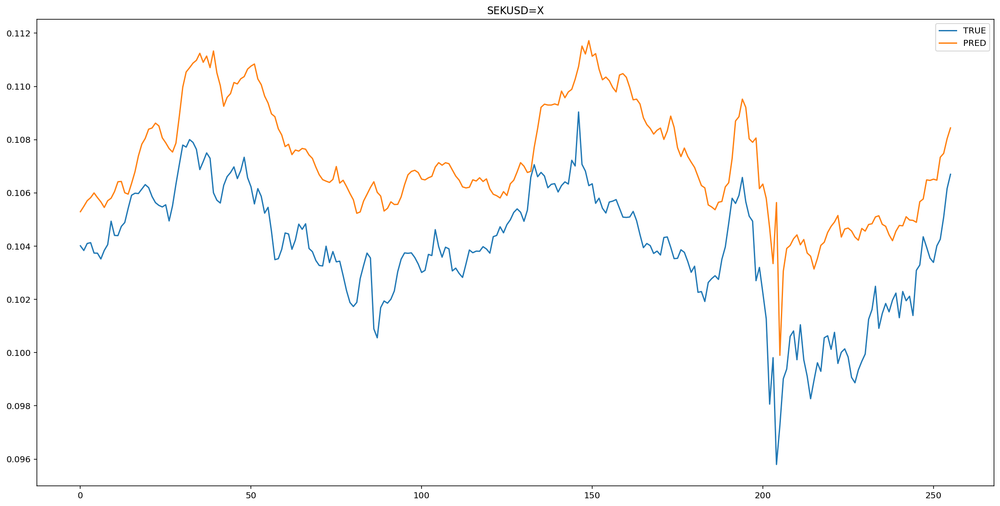

In [88]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

#####Оцениваем точность

In [89]:
table.loc['RNN'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [90]:
MSE(y_hat, y_pred)

0.00021792891

In [91]:
RMSE(y_hat, y_pred)

0.014762416

In [92]:
MAE(y_hat, y_pred)

0.00834232

####LSTM

#####Вычисления

In [93]:
# design network
model = Sequential()
model.add(LSTM(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(LSTM(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 2s - loss: 0.3645 - val_loss: 0.1605
Epoch 2/100
5/5 - 0s - loss: 0.3213 - val_loss: 0.1369
Epoch 3/100
5/5 - 0s - loss: 0.2570 - val_loss: 0.0990
Epoch 4/100
5/5 - 0s - loss: 0.1497 - val_loss: 0.0478
Epoch 5/100
5/5 - 0s - loss: 0.0556 - val_loss: 0.0340
Epoch 6/100
5/5 - 0s - loss: 0.0620 - val_loss: 0.0340
Epoch 7/100
5/5 - 0s - loss: 0.0250 - val_loss: 0.0419
Epoch 8/100
5/5 - 0s - loss: 0.0309 - val_loss: 0.0417
Epoch 9/100
5/5 - 0s - loss: 0.0247 - val_loss: 0.0387
Epoch 10/100
5/5 - 0s - loss: 0.0241 - val_loss: 0.0361
Epoch 11/100
5/5 - 0s - loss: 0.0211 - val_loss: 0.0344
Epoch 12/100
5/5 - 0s - loss: 0.0197 - val_loss: 0.0336
Epoch 13/100
5/5 - 0s - loss: 0.0191 - val_loss: 0.0327
Epoch 14/100
5/5 - 0s - loss: 0.0183 - val_loss: 0.0326
Epoch 15/100
5/5 - 0s - loss: 0.0180 - val_loss: 0.0329
Epoch 16/100
5/5 - 0s - loss: 0.0174 - val_loss: 0.0331
Epoch 17/100
5/5 - 0s - loss: 0.0168 - val_loss: 0.0330
Epoch 18/100
5/5 - 0s - loss: 0.0162 - val_loss: 0.0327
E

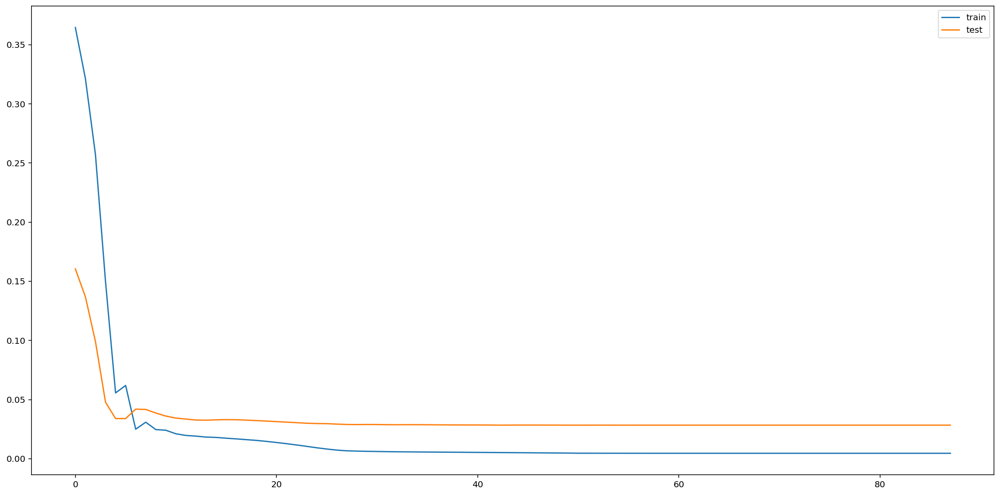

In [94]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [95]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

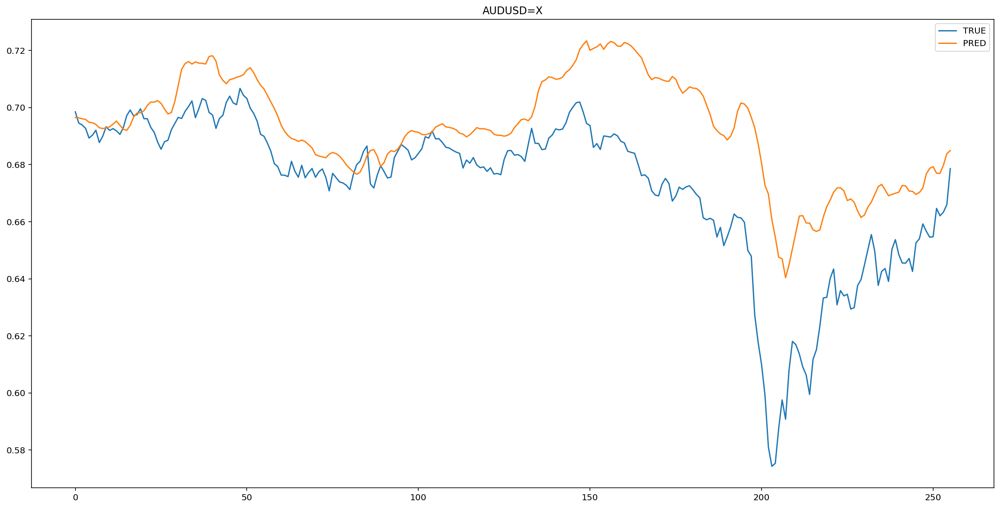

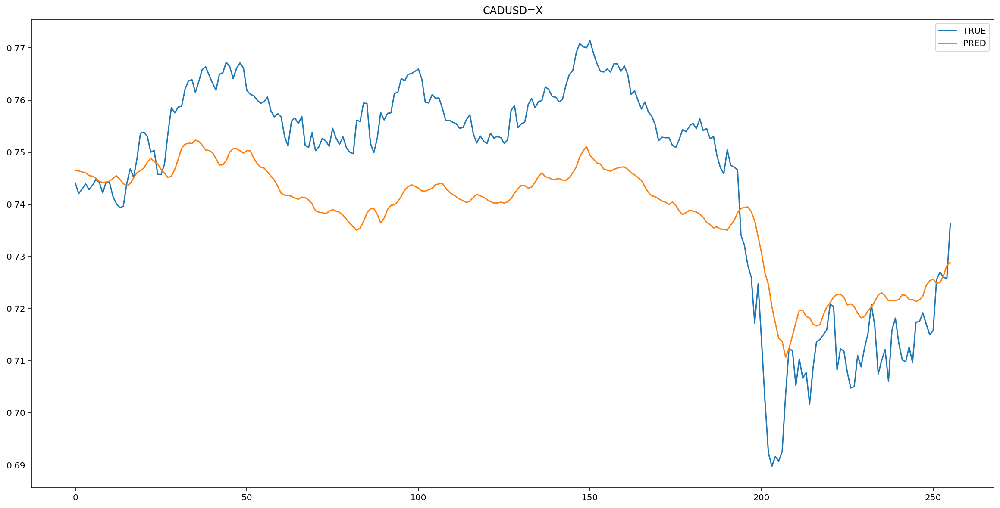

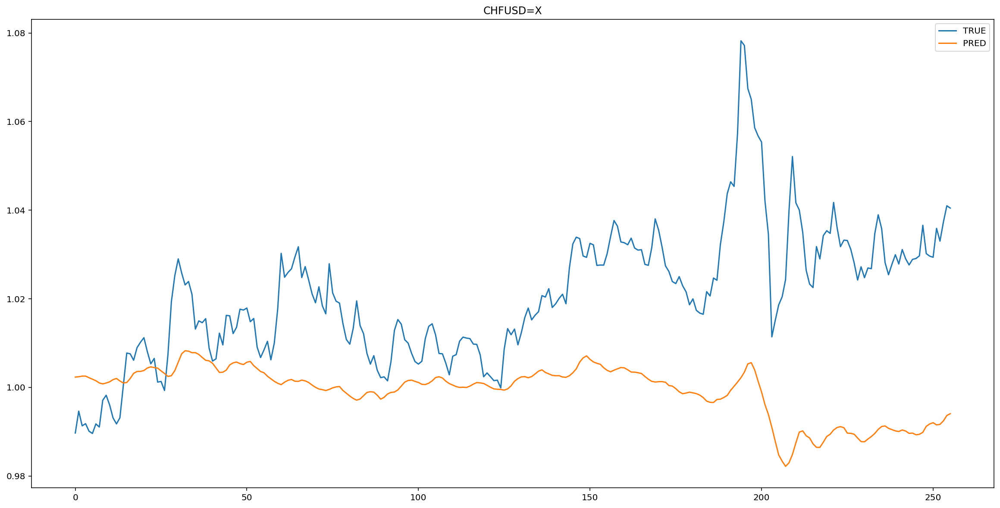

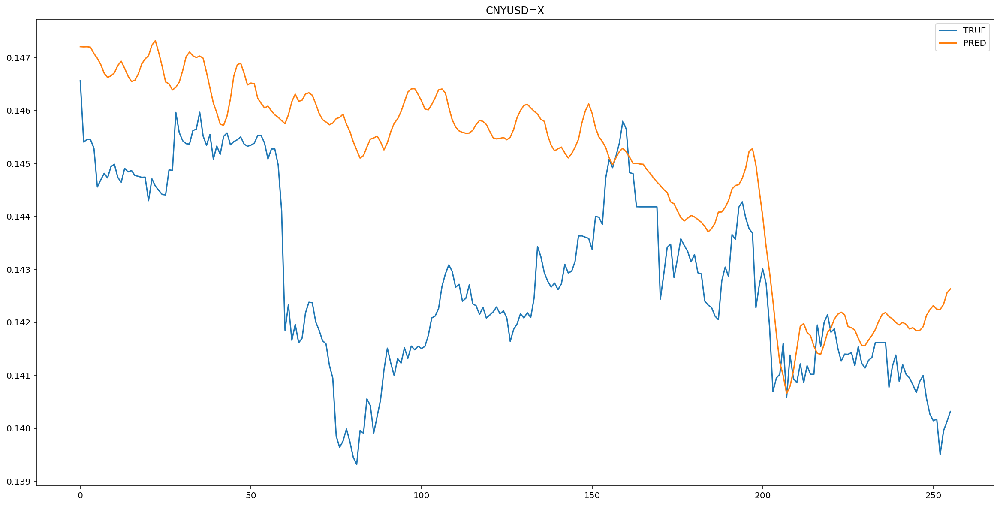

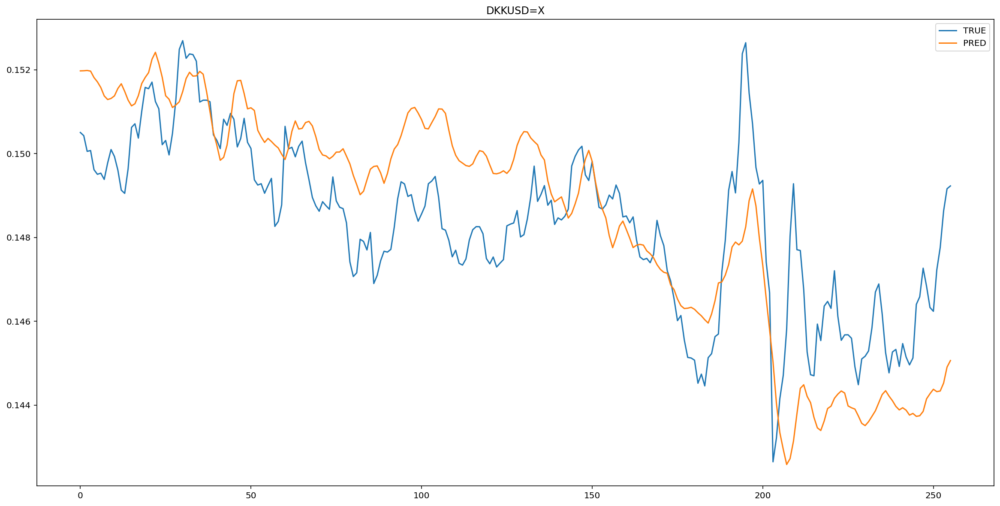

...

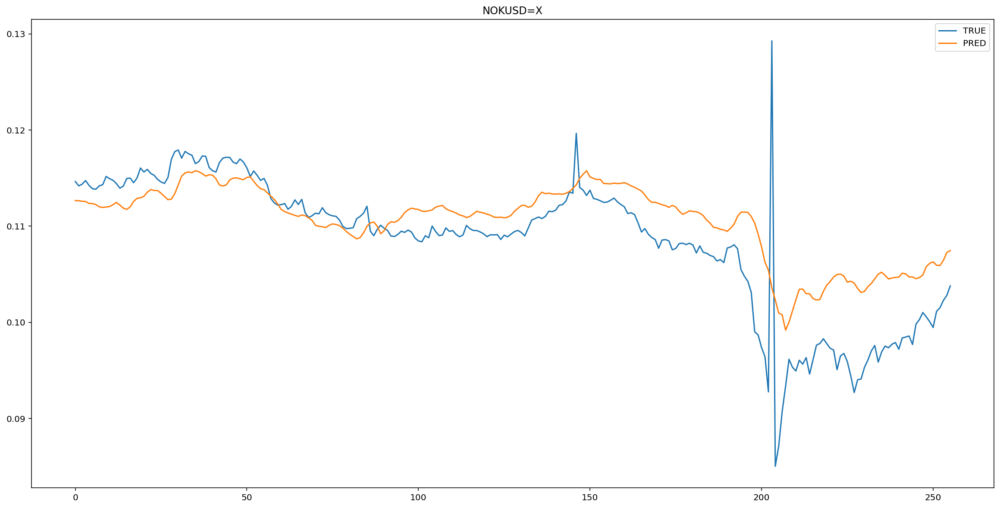

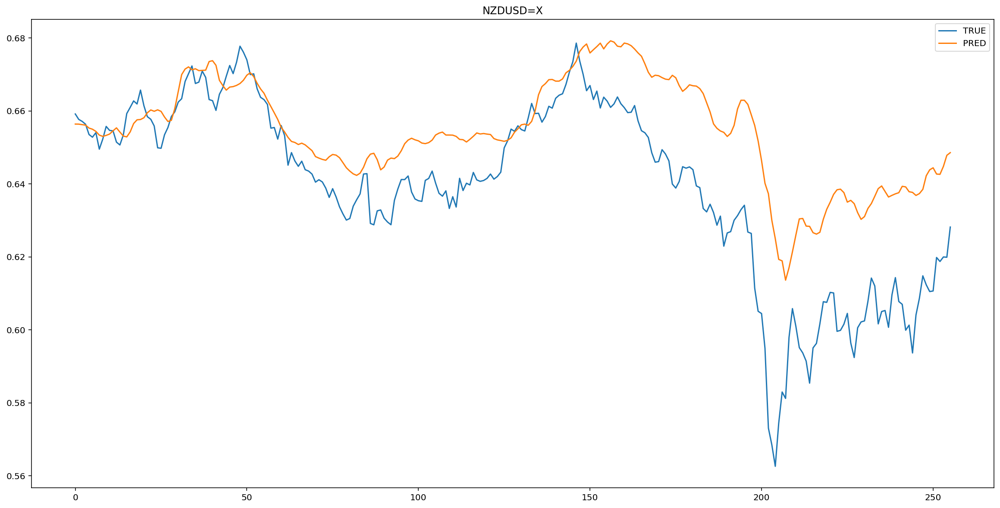

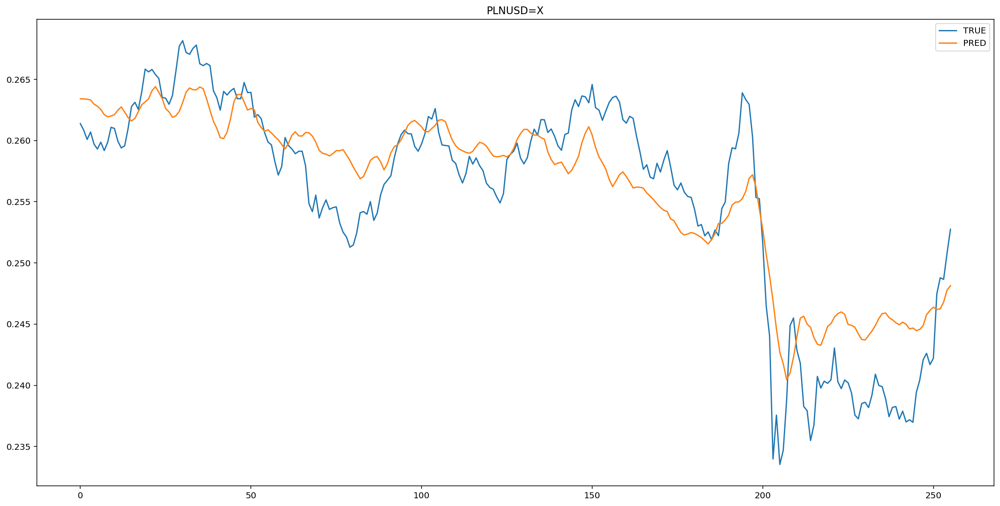

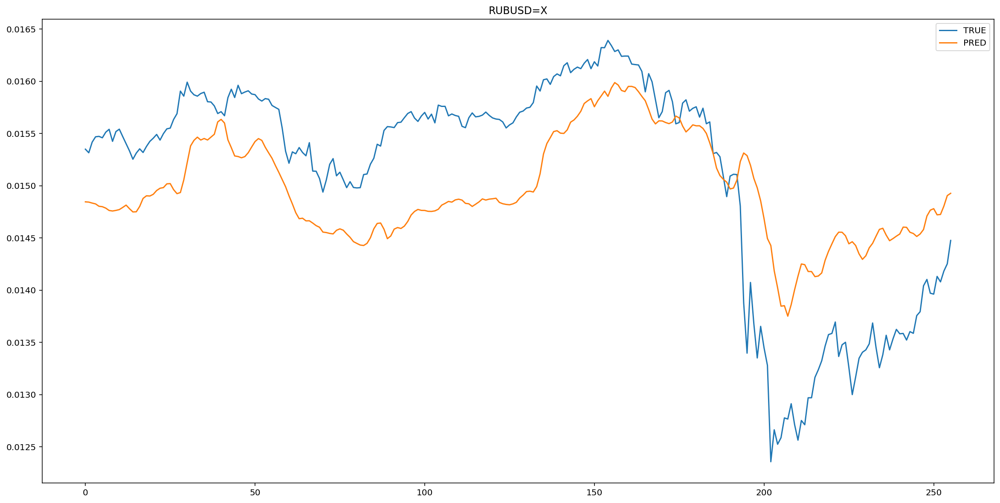

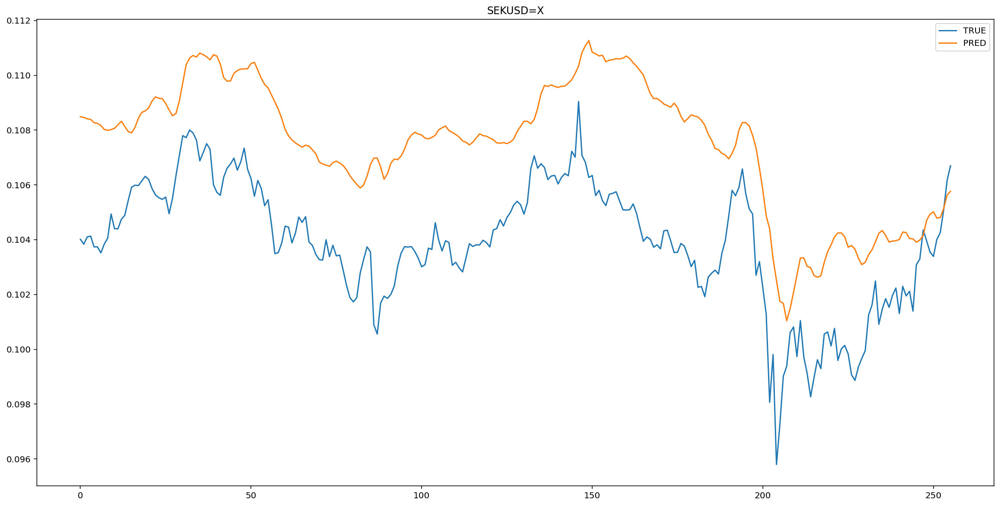

In [96]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

#####Оцениваем точность

In [97]:
table.loc['LSTM'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [98]:
MSE(y_hat, y_pred)

0.00024026068

In [99]:
RMSE(y_hat, y_pred)

0.015500344

In [100]:
MAE(y_hat, y_pred)

0.008635593

####GRU

#####Вычисления

In [101]:
# design network
model = Sequential()
model.add(GRU(128, input_shape=(train_X.shape[1], train_X.shape[2]), return_sequences=True, activation='relu'))
model.add(GRU(128, return_sequences=False, activation='relu'))
model.add(Dense(train_y.shape[1], activation='linear'))
model.compile(loss='mse', optimizer='adam')

Epoch 1/100
5/5 - 2s - loss: 0.3498 - val_loss: 0.1313
Epoch 2/100
5/5 - 0s - loss: 0.2198 - val_loss: 0.0768
Epoch 3/100
5/5 - 0s - loss: 0.0946 - val_loss: 0.0398
Epoch 4/100
5/5 - 0s - loss: 0.0397 - val_loss: 0.0482
Epoch 5/100
5/5 - 0s - loss: 0.0383 - val_loss: 0.0359
Epoch 6/100
5/5 - 0s - loss: 0.0193 - val_loss: 0.0361
Epoch 7/100
5/5 - 0s - loss: 0.0240 - val_loss: 0.0372
Epoch 8/100
5/5 - 0s - loss: 0.0201 - val_loss: 0.0378
Epoch 9/100
5/5 - 0s - loss: 0.0172 - val_loss: 0.0379
Epoch 10/100
5/5 - 0s - loss: 0.0165 - val_loss: 0.0348
Epoch 11/100
5/5 - 0s - loss: 0.0141 - val_loss: 0.0324
Epoch 12/100
5/5 - 0s - loss: 0.0133 - val_loss: 0.0322
Epoch 13/100
5/5 - 0s - loss: 0.0120 - val_loss: 0.0332
Epoch 14/100
5/5 - 0s - loss: 0.0110 - val_loss: 0.0332
Epoch 15/100
5/5 - 0s - loss: 0.0099 - val_loss: 0.0323
Epoch 16/100
5/5 - 0s - loss: 0.0088 - val_loss: 0.0316
Epoch 17/100
5/5 - 0s - loss: 0.0079 - val_loss: 0.0313
Epoch 18/100
5/5 - 0s - loss: 0.0071 - val_loss: 0.0309
E

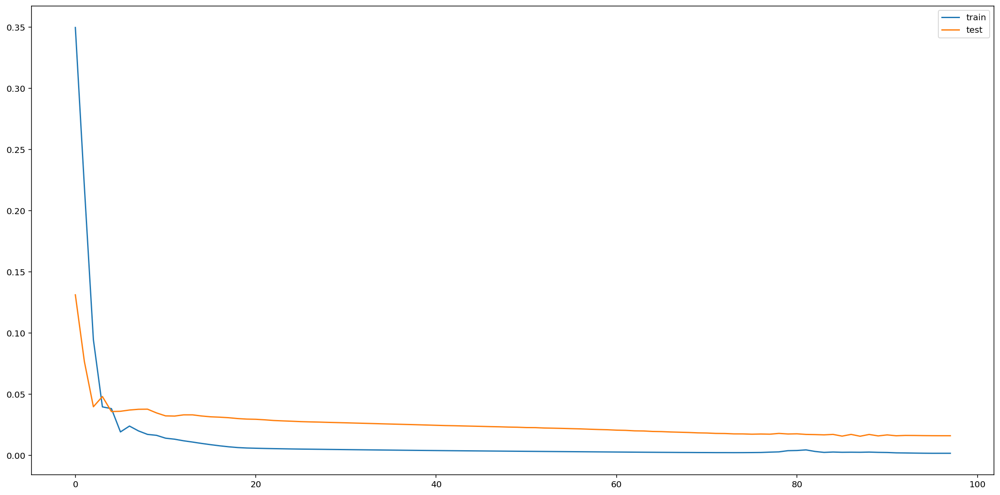

In [102]:
# fit network

earlyStopping = EarlyStopping(monitor='val_loss', patience=10, verbose=0, mode='min')
mcp_save = ModelCheckpoint('.mdl_wts.hdf5', save_best_only=True, monitor='val_loss', mode='min')
reduce_lr_loss = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=7, verbose=1, epsilon=1e-4, mode='min')

history = model.fit(train_X, train_y, epochs=100, batch_size=128, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlyStopping, mcp_save, reduce_lr_loss])
# plot history
fig, ax = plt.subplots(figsize=(20,10))
pyplot.plot(history.history['loss'], label='train')
pyplot.plot(history.history['val_loss'], label='test')
pyplot.legend()
pyplot.show()

In [103]:
y_hat = scaler.inverse_transform(test_y)
y_pred = scaler.inverse_transform(model.predict(test_X))
#y_pred = scaler.inverse_transform(model.predict(test_X.reshape(test_X.shape[0], test_X.shape[1], test_X.shape[2], 1)))

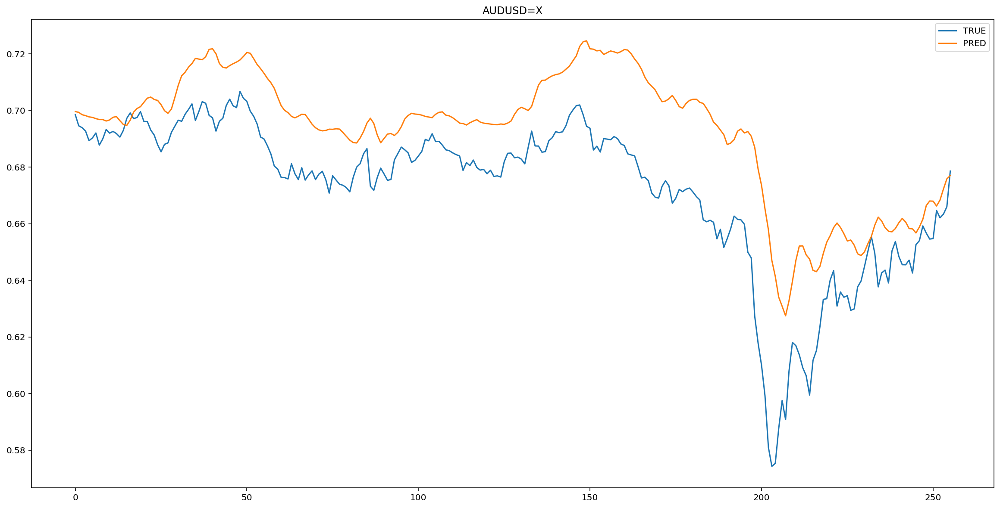

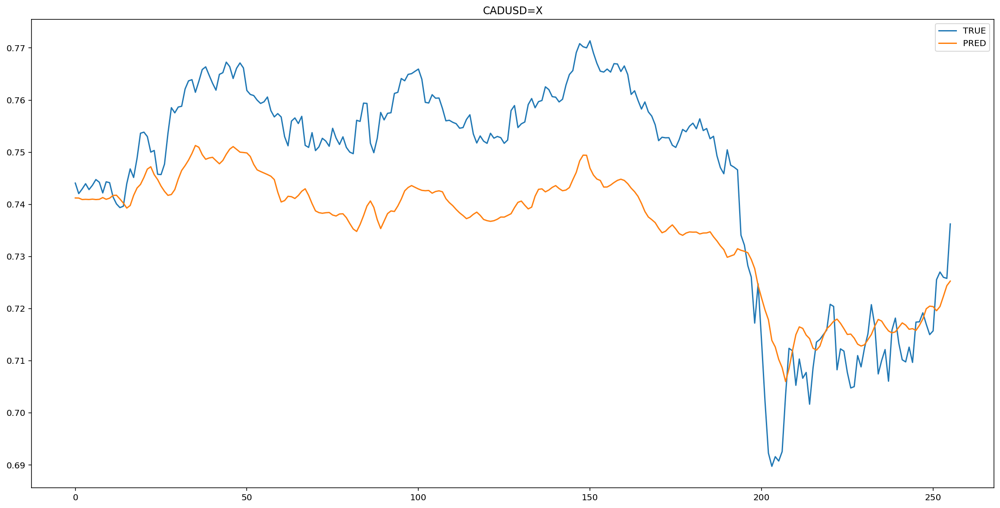

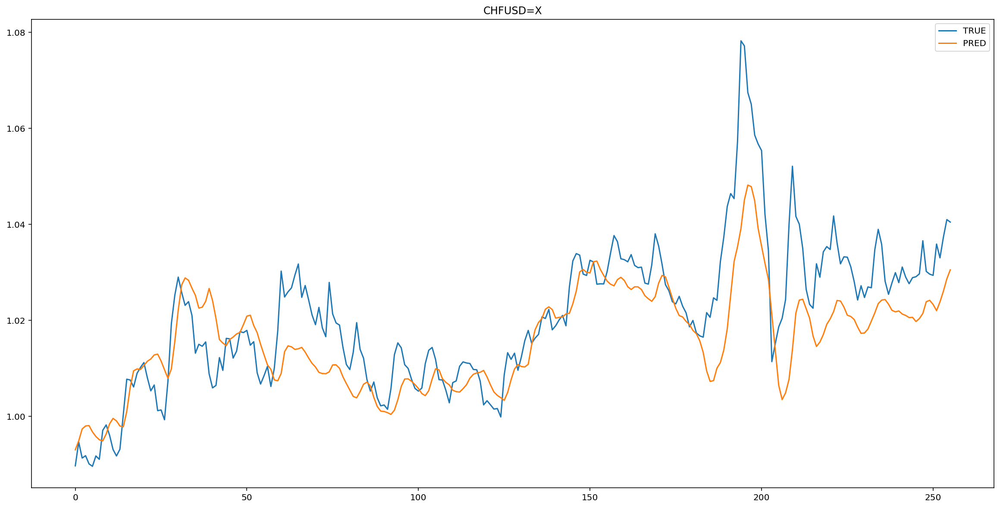

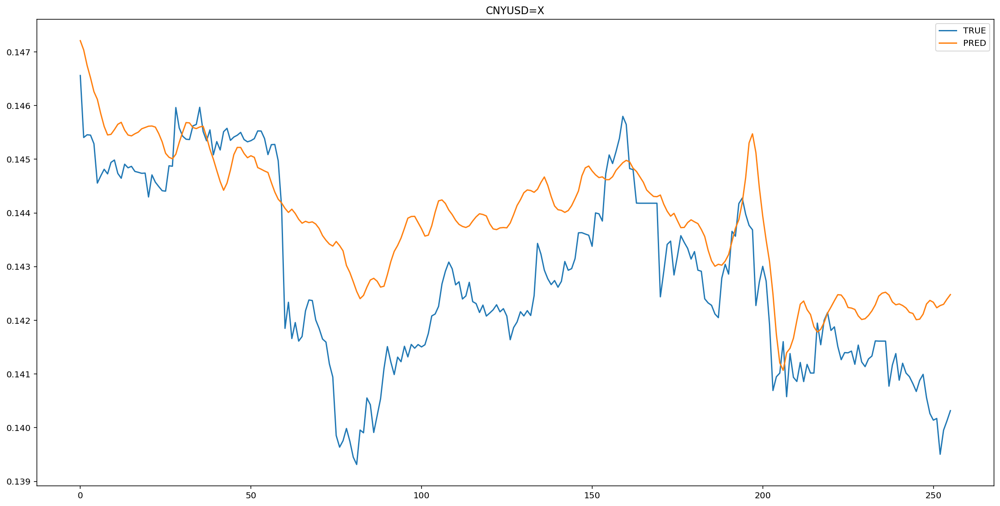

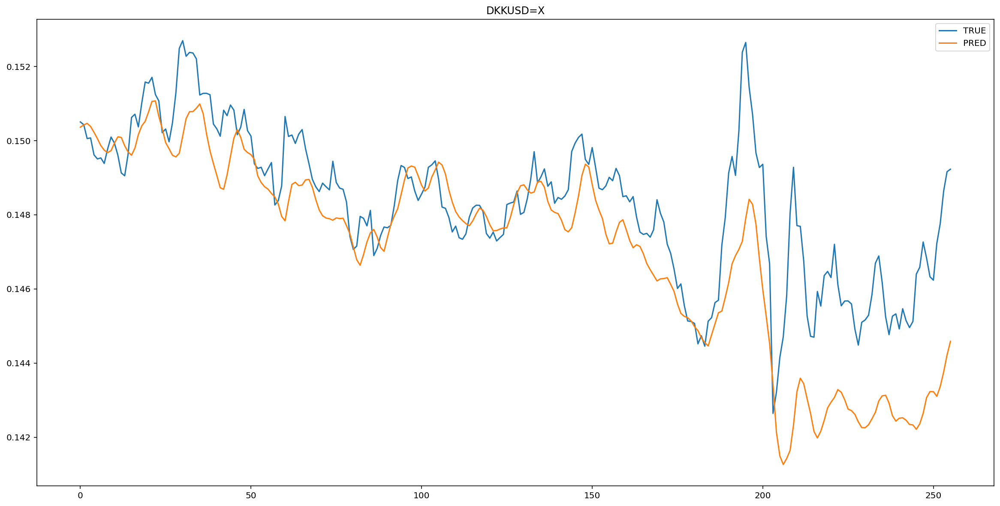

...

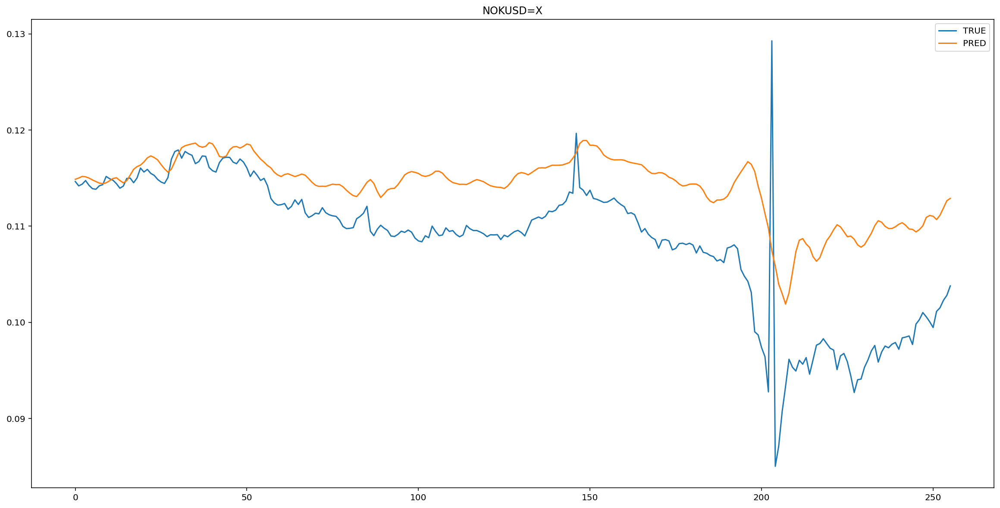

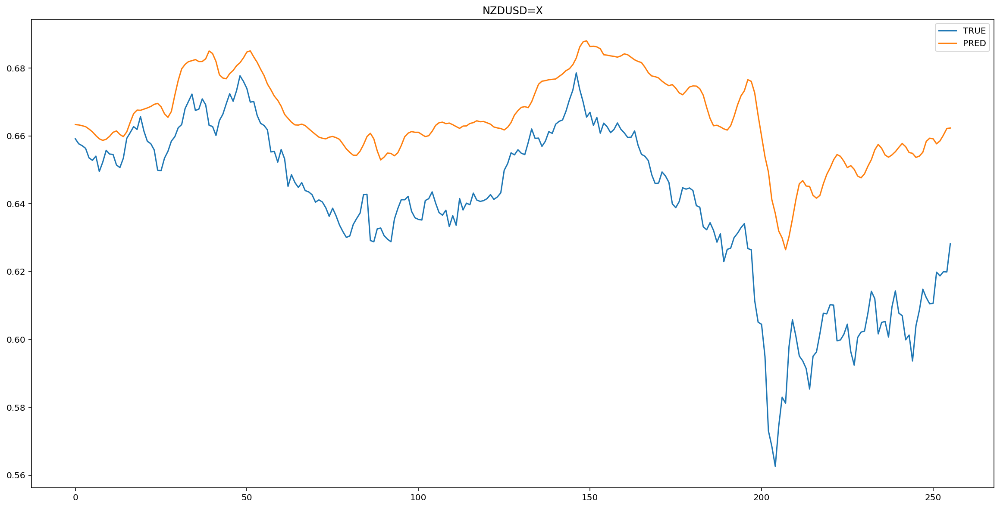

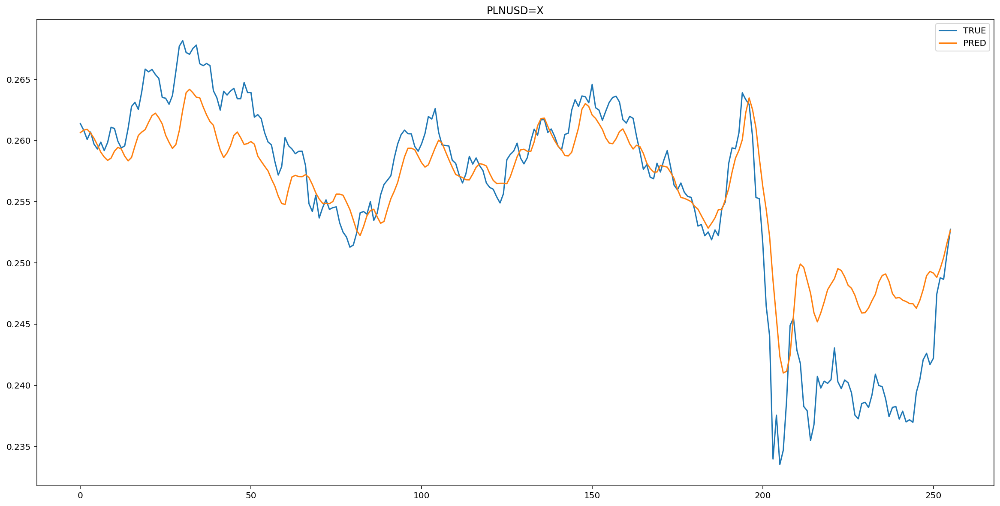

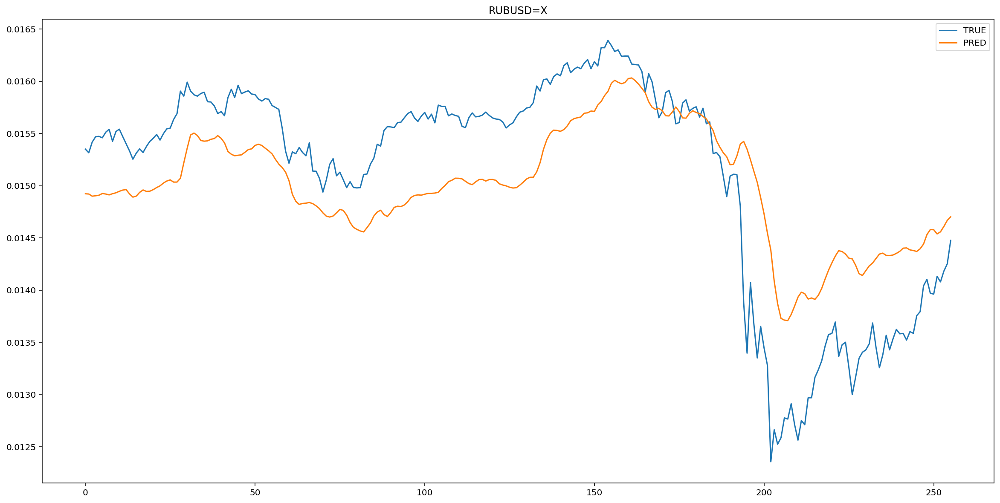

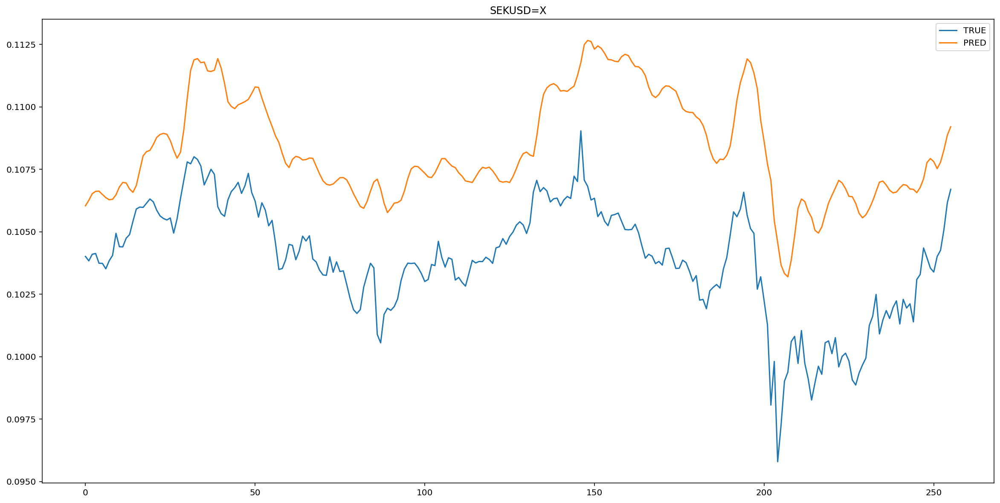

In [104]:
 for i in range(y_hat.shape[1]):
    fig, ax = plt.subplots(figsize=(20,10))
    plt.title(new_data.columns[i])
    pd.DataFrame(y_hat[:, i],columns=['TRUE']).plot(ax = ax)
    pd.DataFrame(y_pred[:, i],columns=['PRED']).plot(ax = ax)
    plt.show()

#####Оцениваем точность

In [105]:
table.loc['GRU'] = [MSE(y_hat, y_pred), RMSE(y_hat, y_pred), MAE(y_hat, y_pred)]

In [106]:
MSE(y_hat, y_pred)

0.00019090137

In [107]:
RMSE(y_hat, y_pred)

0.013816706

In [108]:
MAE(y_hat, y_pred)

0.0076393713

####Комбинированные

#####Вычисления

#####Оцениваем точность

###Комбинации

####Вычисления

####Оцениваем точность

In [109]:
MSE(y_hat, y_pred)

0.00019090137

In [110]:
RMSE(y_hat, y_pred)

0.013816706

In [111]:
MAE(y_hat, y_pred)

0.0076393713

#Сравнение

Таблица:

In [112]:
table

,MSE,RMSE,MAE
naive,0.000058,0.007617,0.003644
mean,0.000071,0.008430,0.003828
moving average,0.000071,0.008404,0.003816
VAR,0.000022,0.004690,0.002295
Perc,0.000269,0.016415,0.009344
Conv,0.000413,0.020327,0.010934
RNN,0.000218,0.014762,0.008342
LSTM,0.000240,0.015500,0.008636
GRU,0.000191,0.013817,0.007639


#Версии

In [113]:
import os

In [114]:
os.system("apt update && apt install -y neofetch")
!neofetch

            .-/+oossssoo+/-. 
        `:+ssssssssssssssssss+:` 
      -+ssssssssssssssssssyyssss+- 
    .ossssssssssssssssssdMMMNysssso. 
   /ssssssssssshdmmNNmmyNMMMMhssssss/ 
  +ssssssssshmydMMMMMMMNddddyssssssss+ 
 /sssssssshNMMMyhhyyyyhmNMMMNhssssssss/ 
.ssssssssdMMMNhsssssssssshNMMMdssssssss. 
+sssshhhyNMMNyssssssssssssyNMMMysssssss+ 
ossyNMMMNyMMhsssssssssssssshmmmhssssssso 
ossyNMMMNyMMhsssssssssssssshmmmhssssssso 
+sssshhhyNMMNyssssssssssssyNMMMysssssss+ 
.ssssssssdMMMNhsssssssssshNMMMdssssssss. 
 /sssssssshNMMMyhhyyyyhdNMMMNhssssssss/ 
  +sssssssssdmydMMMMMMMMddddyssssssss+ 
   /ssssssssssshdmNNNNmyNMMMMhssssss/ 
    .ossssssssssssssssssdMMMNysssso. 
      -+sssssssssssssssssyyyssss+- 
        `:+ssssssssssssssssss+:` 
            .-/+oossssoo+/-. 
root@cc260788acd6 
----------------- 
OS: Ubuntu 18.04.5 LTS x86_64 
Host: Google Compute Engine 
Kernel: 4.19.112+ 
Uptime: 1 hour, 5 mins 
Packages: 1344 
Shell: bash 4.4.20 
Terminal: jupyter-noteboo 
CPU: Intel Xeon (2) @ 2.199G

In [115]:
!python --version

Python 3.7.10


In [116]:
!pip freeze
!pip freeze > requirements.txt 

absl-py==0.10.0
alabaster==0.7.12
albumentations==0.1.12
altair==4.1.0
appdirs==1.4.4
argon2-cffi==20.1.0
asgiref==3.3.1
astor==0.8.1
astropy==4.2
astunparse==1.6.3
async-generator==1.10
atari-py==0.2.6
atomicwrites==1.4.0
attrs==20.3.0
audioread==2.1.9
autograd==1.3
Babel==2.9.0
backcall==0.2.0
beautifulsoup4==4.6.3
bleach==3.3.0
blis==0.4.1
bokeh==2.1.1
Bottleneck==1.3.2
branca==0.4.2
bs4==0.0.1
CacheControl==0.12.6
cachetools==4.2.1
catalogue==1.0.0
certifi==2020.12.5
cffi==1.14.5
chainer==7.4.0
chardet==3.0.4
click==7.1.2
cloudpickle==1.3.0
cmake==3.12.0
cmdstanpy==0.9.5
colorlover==0.3.0
community==1.0.0b1
contextlib2==0.5.5
convertdate==2.3.1
coverage==3.7.1
coveralls==0.5
crcmod==1.7
cufflinks==0.17.3
cupy-cuda101==7.4.0
cvxopt==1.2.6
cvxpy==1.0.31
cycler==0.10.0
cymem==2.0.5
Cython==0.29.22
daft==0.0.4
dask==2.12.0
datascience==0.10.6
debugpy==1.0.0
decorator==4.4.2
defusedxml==0.7.1
descartes==1.1.0
dill==0.3.3
distributed==1.25.3
Django==3.1.7
dlib==19.18.0
dm-tree==0.1.5
doc